# **Classez des images à l'aide d'algorithmes de Deep Learning**
Ce notebook a été réalisé sous Google Colab. 

## **1. Importation des données**

### **1.1. Chargement des librairies**

In [ ]:
# Data manipulation
import numpy as np 
import pandas as pd 

# Math functions
import math

# Access files/directories
import os

# Read and write tar archive files
import tarfile

# Copy files/directories content
import shutil

# Data visualization
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")

# Image manipulation
from PIL import Image

# Neuronal Network tools
import tensorflow as tf
from tensorflow import keras
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, load_model
from keras.layers import (Conv2D, MaxPooling2D, Flatten, Dense, Input, ReLU, 
                          BatchNormalization, Dropout, GlobalAveragePooling2D,
                          DepthwiseConv2D, AvgPool2D, add)
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import Model

# sklearn tools
from sklearn.metrics import confusion_matrix, classification_report

# data persistence
import joblib

In [ ]:
# Access to drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### **1.2. Chargement des données**

Les données (images) sont téléchargeables via cette url http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar 

Nous les récupérons et les stockons dans un répertoire data.

In [ ]:
# Get the data
!wget http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar -P "/content/drive/My Drive/Formation/Dog Classification"

--2022-02-21 06:14:47--  http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar
Resolving vision.stanford.edu (vision.stanford.edu)... 171.64.68.10
Connecting to vision.stanford.edu (vision.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 793579520 (757M) [application/x-tar]
Saving to: ‘/content/drive/My Drive/Formation/Dog Classification/images.tar’

images.tar          100%[===================>] 756.82M  13.1MB/s    in 58s     

2022-02-21 06:15:45 (13.0 MB/s) - ‘/content/drive/My Drive/Formation/Dog Classification/images.tar’ saved [793579520/793579520]



In [ ]:
# Data repository creation
images_dir_path = '/content/drive/My Drive/Formation/Dog Classification'
data_rep = os.path.join(images_dir_path,'data')
os.makedirs(data_rep, exist_ok=True)

Nous allons extraire les données.

In [ ]:
# Open file
my_tar = tarfile.open(images_dir_path+'/images.tar')

# Extract all files in data repository
my_tar.extractall(images_dir_path +'/data')
my_tar.close()

In [ ]:
# Path to the breed files
breed_files_path = os.path.join(data_rep,'Images')

# Breed list of directories
list_breed = os.listdir(breed_files_path)

In [ ]:
# Dictionnary to get for each breed the number of images 
dico_breed = {}

# Count total nb of images
nb_tot_img = 0

# Count number of breeds
nb_breeds = 0

for file in list_breed :
    
    # Count nb of breeds
    nb_breeds += 1
    
    # Get path to the breed file
    file_path = os.path.join(breed_files_path, file)
    
    # Get breed name
    name_breed = file_path.split("-")[-1]
    
    # Initialize number of images
    nb_img = 0
    
    # For each "breed file", get number of images
    for img in os.listdir(file_path) :
        nb_img += 1
        nb_tot_img += 1
        # Add to dictionnary
        dico_breed[name_breed] = nb_img

print(dico_breed)
print("\nNumber of breeds : ", nb_breeds)
print("Total number of images : ", nb_tot_img)

{'haired_fox_terrier': 157, 'Lakeland_terrier': 197, 'Sealyham_terrier': 202, 'Airedale': 202, 'cairn': 197, 'Dandie_Dinmont': 180, 'Boston_bull': 182, 'miniature_schnauzer': 154, 'giant_schnauzer': 157, 'Scotch_terrier': 158, 'Tibetan_terrier': 206, 'silky_terrier': 183, 'coated_wheaten_terrier': 156, 'West_Highland_white_terrier': 169, 'Lhasa': 186, 'coated_retriever': 151, 'golden_retriever': 150, 'Labrador_retriever': 171, 'Chesapeake_Bay_retriever': 167, 'haired_pointer': 152, 'vizsla': 154, 'English_setter': 161, 'Irish_setter': 155, 'Gordon_setter': 153, 'Brittany_spaniel': 152, 'clumber': 150, 'English_springer': 159, 'Welsh_springer_spaniel': 150, 'cocker_spaniel': 159, 'kuvasz': 150, 'schipperke': 154, 'groenendael': 150, 'briard': 152, 'kelpie': 153, 'Old_English_sheepdog': 169, 'collie': 153, 'Border_collie': 150, 'Rottweiler': 152, 'German_shepherd': 152, 'miniature_pinscher': 184, 'Greater_Swiss_Mountain_dog': 168, 'Bernese_mountain_dog': 218, 'Appenzeller': 151, 'boxer':

Les images sont stockées dans le répertoire Images du dataset. Ensuite, il y a un répertoire par race de chiens (breed en anglais), nous comptons 120 races au total. 

## **2. Visualisation des données**

### **2.1. Répartition du nombre d'images selon la race de chien**
Nous regardons si les dossiers contiennent des nombres similaires d'images par race de chien.

In [ ]:
# Dataframe for breed information
df_breeds = pd.DataFrame(data = dico_breed.values(), 
                        index = dico_breed.keys(),
                        columns = ["nb_images"]
                       )

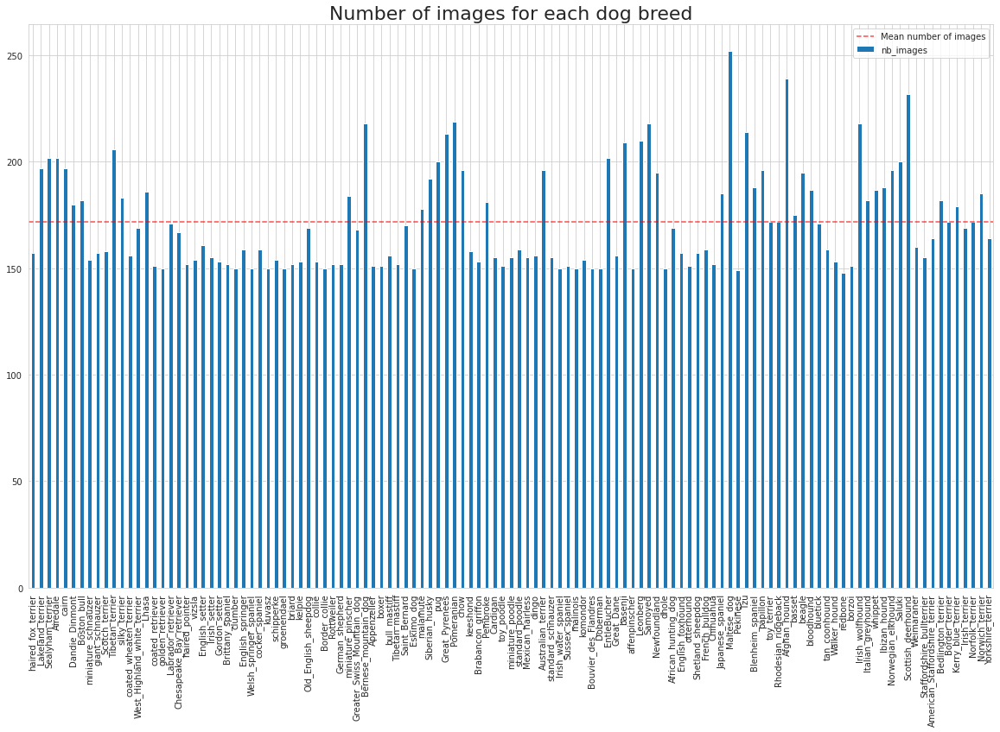

Mean number of images :  171.6638655462185


In [ ]:
# Plot breeds numbers
fig, ax = plt.subplots(1, 1, figsize=(20,12))
df_breeds.plot(kind="bar",
               legend=False,
               ax=ax)
# Line to plot the mean number of images
ax.axhline(df_breeds["nb_images"].mean(),
           color='r', alpha=.7,
           linestyle='--',
           label="Mean number of images")
plt.title("Number of images for each dog breed", fontsize=22)
plt.legend()
plt.show()

print("Mean number of images : ", df_breeds["nb_images"].mean())

Les images sont assez bien réparties selon les races. Nous comptons en moyenne 171 images par race.

### **2.2. Visualisation des images**
**1 image par race**

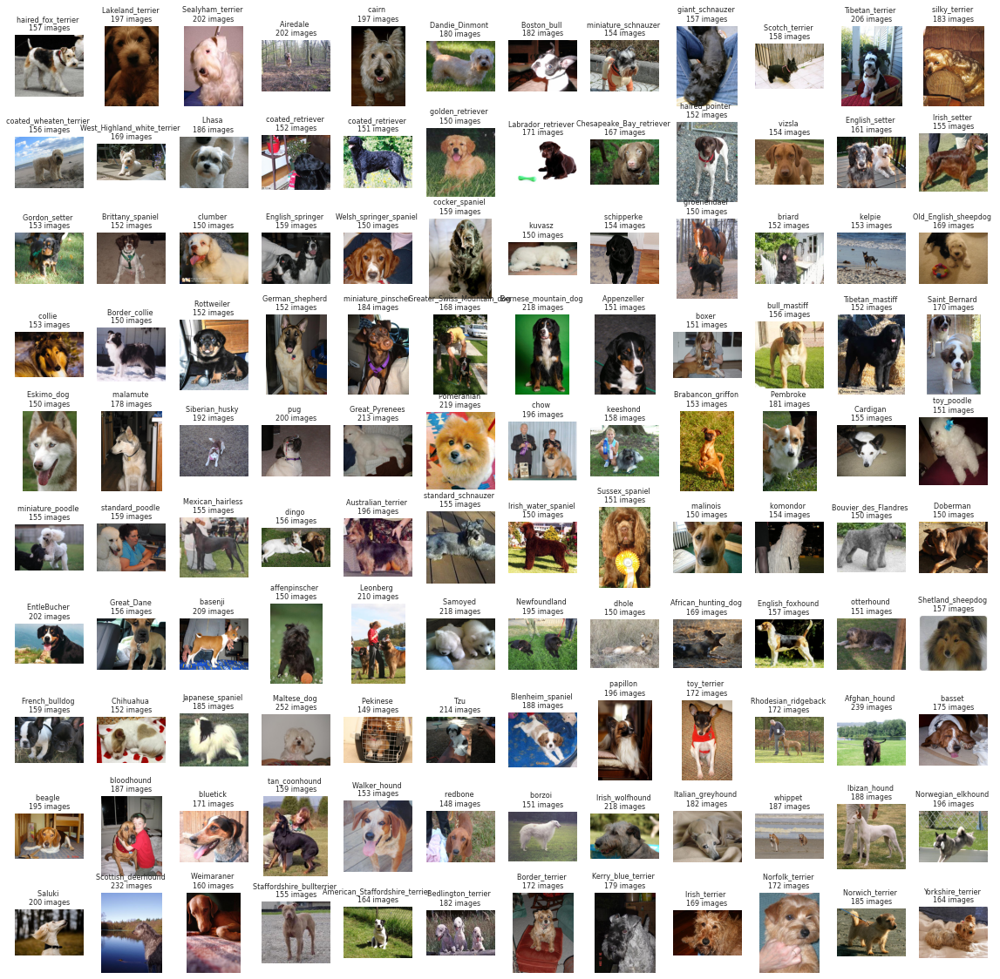

In [ ]:
# Display all breeds with 1 image each and total number of images
plt.figure(figsize=(20, 20))

# Iniate counter
j = 0

# For each breed
for i in range(120):
  # Subplot
  ax = plt.subplot(10, 12, j + 1)
  # Get breed list of images
  images = os.listdir(breed_files_path + "/" + list_breed[i])
  plt.title("{} \n{} images".format(list_breed[i].split("-")[-1], 
            len(images)),
                 fontsize=8
            )
  # Random index
  x = np.random.randint(0, len(images))
  img = Image.open(
        breed_files_path + "/" + list_breed[i] +  "/" + images[x])
  j+=1
  plt.imshow(img)
  plt.axis("off")

**16 races au hasard**

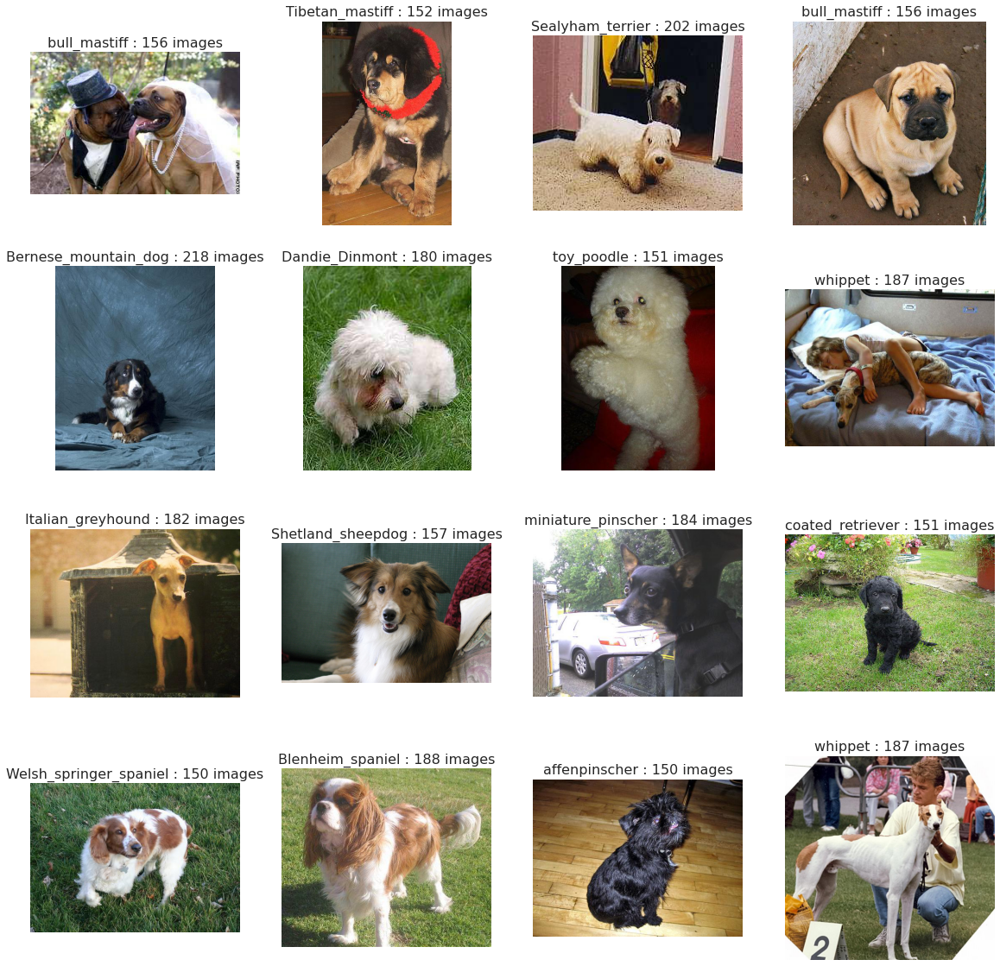

In [ ]:
# Display 16 random breeds with 1 image each and total number of images
plt.figure(figsize=(20, 20))

# Iniate counter
j = 0

# Choose 16 randoms breeds 
for i in np.random.randint(0, len(list_breed), size =16):
  # Subplot
  ax = plt.subplot(4, 4, j + 1)
  # Get breed list of images
  images = os.listdir(breed_files_path + "/" + list_breed[i])
  plt.title("{} : {} images".format(list_breed[i].split("-")[-1], 
            len(images)),
                 fontsize=16
            )
  # Random index
  x = np.random.randint(0, len(images))
  img = Image.open(
        breed_files_path + "/" + list_breed[i] +  "/" + images[x])
  j+=1
  plt.imshow(img)
  plt.axis("off")

**Plusieurs images d'une même race**

Nous regardons au sein d'une même race comment sont quelques images.

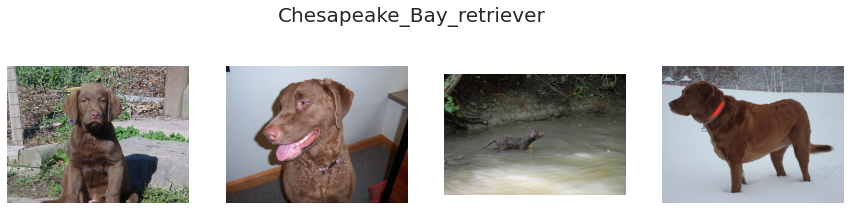

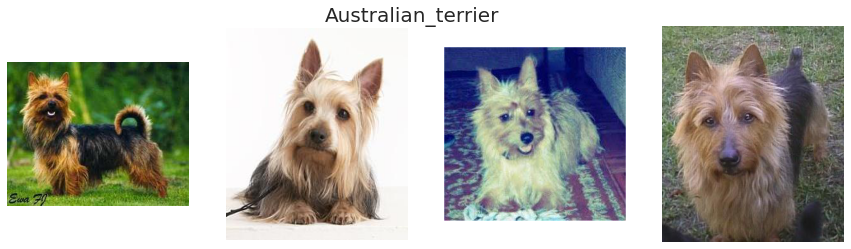

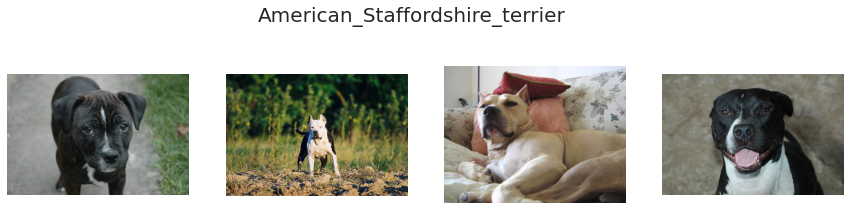

In [ ]:
# Display 3 random breeds with 4 images each
for i in np.random.randint(0, len(list_breed), size=3):
    fig = plt.figure(figsize=(15,12))
    plt.suptitle("{}".format(list_breed[i].split("-")[-1]), 
                 fontsize=20, 
                 y = 0.65)
    
    # Get 4 images of breed list
    images = os.listdir(breed_files_path + "/" + list_breed[i])[:4]

    # Display 4 images
    for j in range(4):
        img = Image.open(breed_files_path + "/" + list_breed[i] +  "/" + images[j])
        plt.subplot(1, 4, j+1)
        plt.imshow(img)
        plt.axis('off')
    plt.show()


### **2.3. Effet du redimensionnement de l'image**
Nous constatons que les chiens ne sont pas forcément au centre de chaque image et que le zoom n'est pas le même. Par ailleurs, les photos n'ont pas toutes la même taille. Or, lorsque les images vont être "injectées" dans le modèle, il faut que leurs tailles soient identiques. Nous devons donc les redimensionner.

Voyons cet effet sur une image test :

In [ ]:
# Image test
# Path to Great_Pyrenees breed file
great_pyr_file_path = breed_files_path + "/n02111500-Great_Pyrenees"

# List of images
list_great_pyr_img = os.listdir(great_pyr_file_path)

# Path to one image
great_pyr_img_path = os.path.join(great_pyr_file_path,list_great_pyr_img[0])

original_img = Image.open(great_pyr_img_path)

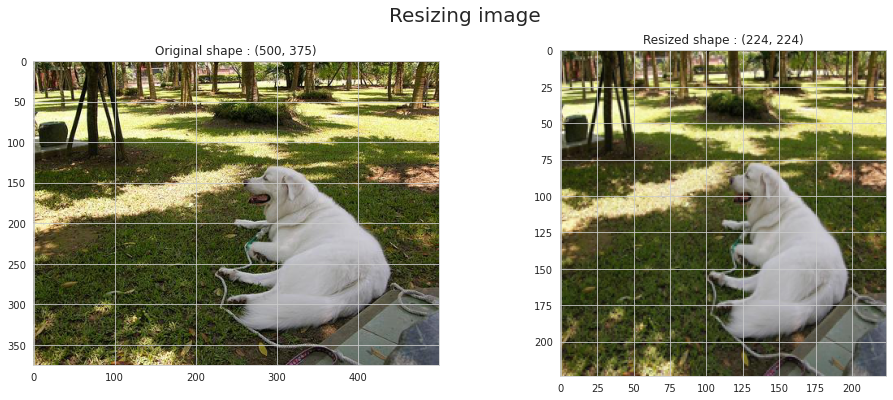

In [ ]:
# setting dimension of the resize
SIZE = 224

# resize image
resized_img = original_img.resize((SIZE, SIZE))

# Show both images
fig = plt.figure(figsize=(16,6))
plt.subplot(1, 2, 1)
plt.imshow(original_img)
plt.title("Original shape : {}".format(original_img.size))
plt.subplot(1, 2, 2)
plt.imshow(resized_img)
plt.title("Resized shape : {}".format(resized_img.size))
plt.suptitle("Resizing image",
             fontsize=20)
plt.show()

Le redimensionnement des images les déforme.

## **3. Split des données**
Afin d'effectuer les différents tests de modèles, nous allons splitter les données (les images) en : 80% Train/Validation et 20% Test, avec 65% Train et 15% Validation (par rapport au dataset global).

Nous créons d'abord des répertoires pour stocker les données splitées.

In [ ]:
# Directories creation to put images inside
train_path = data_rep + "/Train_set"
os.makedirs(train_path, exist_ok=True)

validation_path = data_rep + "/Validation_set"
os.makedirs(validation_path, exist_ok=True)

test_path = data_rep + "/Test_set"
os.makedirs(test_path, exist_ok=True)

Nous répartissons les images dans les différents répertoires pour créer les datasets.

In [ ]:
# Threshold for each set
validation_threshold = 0.65
test_threshold = validation_threshold + 0.15

# Initiate size of datasets
train_size = 0
validation_size = 0
test_size = 0

for file in list_breed :
    
    # Get path to the breed file
    file_path = os.path.join(breed_files_path, file)
    
    # Create path access and directory for each dataset
    breed_train_path = os.path.join(train_path, file)
    os.makedirs(breed_train_path, exist_ok=True)
    breed_validation_path = os.path.join(validation_path, file)
    os.makedirs(breed_validation_path, exist_ok=True)
    breed_test_path = os.path.join(test_path, file)
    os.makedirs(breed_test_path, exist_ok=True)
    
    # Get list of images
    list_img = os.listdir(file_path)
    
    # Get index for datasets with ceil method (Smallest integer not less than x)
    breed_validation_threshold = math.ceil(len(list_img) * validation_threshold)
    breed_test_threshold = math.ceil(len(list_img) * test_threshold)
    
    # List of images for each dataset
    breed_train_set = list_img[:breed_validation_threshold]
    breed_validation_set = list_img[
      breed_validation_threshold:breed_test_threshold]
    breed_test_set = list_img[breed_test_threshold:len(list_img)]
    
    # For each "breed_train_set", get number of images = train_size
    # and copy it in right directory
    for img in breed_train_set :
        train_size += 1
        # Copy image in folder
        source = os.path.join(file_path, img)
        destination = os.path.join(breed_train_path, img)
        dest = shutil.copy(source, destination)
    
    # For each "breed_validation_set", get number of images = validation_size
    # and copy it in right directory
    for img in breed_validation_set :
        validation_size += 1
        # Copy image in folder
        source = os.path.join(file_path, img)
        destination = os.path.join(breed_validation_path, img)
        dest = shutil.copy(source, destination)

    # For each "breed_test_set", get number of images = test_size
    # and copy it in right directory
    for img in breed_test_set :
        test_size += 1
        # Copy image in folder
        source = os.path.join(file_path, img)
        destination = os.path.join(breed_test_path, img)
        dest = shutil.copy(source, destination)

print("Number of images in train set : ",train_size)
print("Number of images in validation set : ",validation_size)
print("Number of images in test set : ",test_size)

# Check if every image has been affected to a dataset
if (train_size + validation_size + test_size) == nb_tot_img :
    print("\nImages distribution is successful")
else :
    print("Bad distribution, retry")

Number of images in train set :  13436
Number of images in validation set :  3072
Number of images in test set :  4072

Images distribution is successful


## **4. Création d'un VGG-16 et entrainement**

### **4.1. Pré-traitement des images** 
Nous allons utiliser ImageDataGenerator qui permet de générer des lots de données d'images (batch) de tenseurs avec une augmentation de données en temps réel. Il permet ainsi de réaliser le préprocessing des images, même pendant l'entrainement du modèle. 

Nous modifions la valeur des pixels pour que leurs valeurs soient comprises entre 0 et 1 (au lieu de [0,255]). Ainsi, chaque image est traitée de la même manière. La mise à l'échelle de toutes les images dans la même plage [0,1] fera en sorte que les images contribuent plus uniformément à la perte totale.

Pour VGG-16, les images en entrée doivent avoir une taille de 224x224. 

In [ ]:
# Create data generator
datagen = ImageDataGenerator(rescale=1./255)

# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 32

Nous créons ensuite un itérateur pour le trainset et le validationset depuis leurs réportoires respectifs, où les images sont organisées en sous répertoires selon leur classe (= race).

In [ ]:
# Create iterator for trainset
train_iterator = datagen.flow_from_directory(train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical")

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical')

Found 13436 images belonging to 120 classes.
Found 3072 images belonging to 120 classes.


### **4.2. Création du VGG-16**
Nous créons maintenant le VGG-16 en ajoutant les couches sucessivement.

In [ ]:
# Initialize the neural network
model_VGG16 = Sequential()

# Add Convolution Layers + Pooling Layers
# 1st convolution layer + ReLU
model_VGG16.add(Conv2D(input_shape=(224,224,3),filters=64,kernel_size=(3,3),
                       padding="same", activation="relu"))
# 2nd convolution layer + ReLU
model_VGG16.add(Conv2D(filters=64,kernel_size=(3,3),
                       padding="same", activation="relu"))
# 1st pooling layer
model_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 3rd convolution layer + ReLU
model_VGG16.add(Conv2D(filters=128,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 4th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=128,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 2nd pooling layer
model_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 5th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 6th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 7th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 3nd pooling layer
model_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 8th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 9th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 10th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 4th pooling layer
model_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 11th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 12th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 13th convolution layer + ReLU
model_VGG16.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 5th pooling layer
model_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

In [ ]:
# Add Dense Layers
# Transform 3D matrix to 1D vector
model_VGG16.add(Flatten())
# 1st fully-connected layer + ReLU
model_VGG16.add(Dense(4096, activation='relu'))
# 2nd fully-connected layer + ReLU
model_VGG16.add(Dense(4096, activation='relu'))
# last fully-connected layer to classify the 120 breeds
model_VGG16.add(Dense(nb_breeds, activation='softmax'))
model_VGG16.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 64)     0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 128)     73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 128)      0         
 2D)                                                    

Keras permet de visualiser et de sauvegarder l'architecture du réseau de neurones sous forme d'une image.

In [ ]:
# Create repository to save images
my_img_path = os.path.join(images_dir_path, "my_images")
os.makedirs(my_img_path, exist_ok=True)
# Save this architecture as an image 
tf.keras.utils.plot_model(model_VGG16, my_img_path + "/my_vgg16_model.png", 
                          show_shapes=True)

In [ ]:
# Create repository to save models
models_path = os.path.join(images_dir_path, "models")
os.makedirs(models_path, exist_ok=True)
model_file_path = models_path + "/my_vgg16_model.h5"

### **4.3. Entrainement du modèle**

#### **Compilation du modèle**
Nous compilons le modèle en précisant les informations suivantes :
- Loss Function : pour calculer la loss du modèle. Nous utilisons "categorical cross-entropy" car il s'agit d'un problème de classification multiclasses
- Optimizer : pour optimiser la loss function. Nous utilisons la descente de gradient (SGD) avec les paramètres par défaut. Il s'agit du plus basique optimizer.

In [ ]:
model_VGG16.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.SGD(),
              # default value learning_rate = 0.01  
              metrics=["accuracy"])

#### **Utilisation de callbacks**
Nous utilisons un call-back pour enregistrer notre modèle, en surveillant l'accuracy du jeu de validation. Le modèle ne sera enregistré sur le disque que si l'accuracy du jeu de validation du modèle de l'epoch en cours est supérieure à celle de l'epoch précédente.

EarlyStopping nous aide à arrêter l'entrainement du modèle plus tôt, s'il n'y a pas d'augmentation de l'accuracy du jeu de de validation. En fixant patience à 20, le modèle arrêtera de s'entraîner s'il ne voit aucune augmentation de l'accuracy du jeu de validation pendant 20 epochs.

In [ ]:
checkpoint = ModelCheckpoint(filepath = model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

early_stop = EarlyStopping(monitor='val_accuracy', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='max')

#### **Entrainement du modèle**
Nous entrainons le modèle sur 100 epochs

In [ ]:
%%time

epochs = 100

history = model_VGG16.fit(
                train_iterator,
                steps_per_epoch = train_size // BATCH_SIZE, #default value
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
419/419 [==============================] - ETA: 0s - loss: 4.7853 - accuracy: 0.0121
Epoch 1: val_accuracy improved from -inf to 0.01237, saving model to /content/drive/My Drive/Formation/Dog Classification/models/my_vgg16_model.h5
419/419 [==============================] - 381s 909ms/step - loss: 4.7853 - accuracy: 0.0121 - val_loss: 4.7840 - val_accuracy: 0.0124
Epoch 2/100
419/419 [==============================] - ETA: 0s - loss: 4.7838 - accuracy: 0.0122
Epoch 2: val_accuracy did not improve from 0.01237
419/419 [==============================] - 379s 904ms/step - loss: 4.7838 - accuracy: 0.0122 - val_loss: 4.7822 - val_accuracy: 0.0124
Epoch 3/100
419/419 [==============================] - ETA: 0s - loss: 4.7821 - accuracy: 0.0122
Epoch 3: val_accuracy did not improve from 0.01237
419/419 [==============================] - 379s 904ms/step - loss: 4.7821 - accuracy: 0.0122 - val_loss: 4.7801 - val_accuracy: 0.0124
Epoch 4/100
419/419 [==============================] - 

#### **Visualisation des résultats**

In [ ]:
def plot_learning_curve(history, model) :
  """
    Function to plot learning curve for accuracy and loss

    Arguments :
    - history
    - model : title of the plot, indicating type of model (string)

    Display :
    - 2 graphs : one for the accuray and the other one for the loss
  """

  # Figure initialisation
  f, axes = plt.subplots(figsize=(15, 8))

  # Accuracy visualization
  plt.subplot(121)
  plt.plot(history.history['accuracy'], label="Training Accuracy")
  plt.plot(history.history['val_accuracy'], label="Validation Accuracy")
  plt.ylabel("Accuracy")
  plt.xlabel("Epoch")
  plt.legend()
  plt.title("{} Accuracy".format(model))

  # Loss visualization
  plt.subplot(122)
  plt.plot(history.history['loss'], label="Training Loss")
  plt.plot(history.history['val_loss'], label="Validation Loss")
  plt.title("{} Loss".format(model))
  plt.ylabel("Loss")
  plt.xlabel("Epoch")
  plt.legend()
  plt.show()

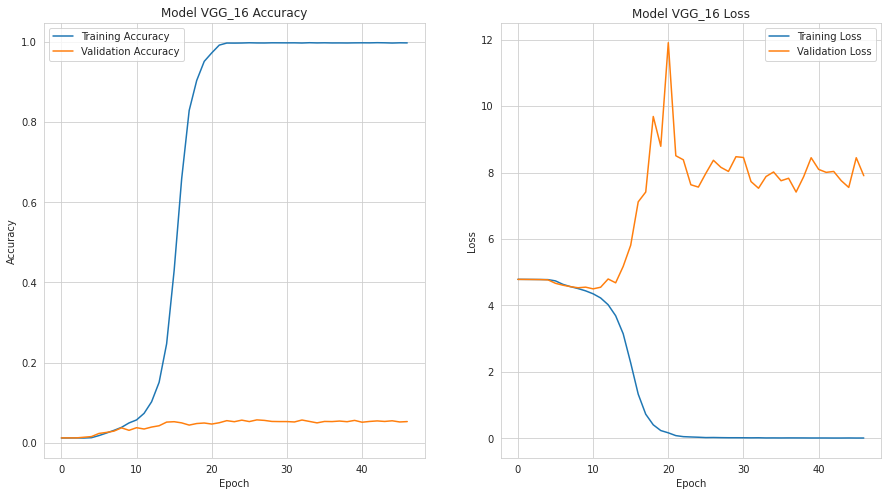

In [ ]:
plot_learning_curve(history, "Model VGG_16")

L'apprentissage a duré longtemps (plus de 5h) et s'est arrêté au bout de 47 epochs car l'accuracy sur le jeu de validation ne s'améliorait pas depuis 20 epochs.

Sur le jeu de train, jusqu'à environ 5 epochs, le modèle apprend peu. Puis, il apprend plus, jusqu'à overfitter à partir de 20 epochs. 

Par contre, sur le jeu de validation, l'accuracy est faible (< 0.1).

### **4.4. Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical')

Found 4072 images belonging to 120 classes.


In [ ]:
# Model evaluation
model_VGG16_eval = model_VGG16.evaluate(test_iterator, steps=test_size // BATCH_SIZE)
print("Loss on test set = ", model_VGG16_eval[0])
print("nAccuracy on test set = ",model_VGG16_eval[1])

127/127 [==============================] - 41s 324ms/step - loss: 7.8331 - accuracy: 0.0642
Loss on test set =  7.833061695098877
nAccuracy on test set =  0.06422244012355804


L'accuracy sur le jeu de test est vraiment faible : le modèle a du mal à généraliser.

### **4.5. Amélioration du modèle**
Nous effectuons les modifications suivantes pour tenter d'améliorer le modèle :
- utilisation de l'optimizer `Adam` qui permet une convergence plus rapide du gradient ; nous prenons un learning rate plus faible (0.001)
- ajoût de couches `BatchNormalization` qui augmente la vitesse d'entrainement du modèle et le rend plus stable
- ajoût de couches `DropOut` pour diminuer l'overfitting du modèle.

#### **Construction du nouveau modèle**


In [ ]:
# Initialize the neural network
model_VGG16_1 = Sequential()

# Add Convolution Layers + Pooling Layers
# 1st convolution layer + ReLU
model_VGG16_1.add(Conv2D(input_shape=(224,224,3),filters=64,kernel_size=(3,3),
                       padding="same", activation="relu"))
# 2nd convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=64,kernel_size=(3,3),
                       padding="same", activation="relu"))
# 1st pooling layer
model_VGG16_1.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 3rd convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=128,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 4th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=128,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 2nd pooling layer
model_VGG16_1.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 5th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 6th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 7th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 3nd pooling layer
model_VGG16_1.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 8th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 9th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 10th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 4th pooling layer
model_VGG16_1.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 11th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 12th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 13th convolution layer + ReLU
model_VGG16_1.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 5th pooling layer
model_VGG16_1.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

# Add Dense Layers
# Transform 3D matrix to 1D vector
model_VGG16_1.add(Flatten())
# 1st fully-connected layer + ReLU
model_VGG16_1.add(Dense(4096, activation='relu'))
# 1st BatchNormalization layer
model_VGG16_1.add(BatchNormalization())
# 1st Dropout layer
model_VGG16_1.add(Dropout(0.5))
# 2nd fully-connected layer + ReLU
model_VGG16_1.add(Dense(4096, activation='relu'))
# 2nd BatchNormalization layer
model_VGG16_1.add(BatchNormalization())
# 2nd Dropout layer
model_VGG16_1.add(Dropout(0.5))
# last fully-connected layer to classify the 120 breeds
model_VGG16_1.add(Dense(nb_breeds, activation='softmax'))

In [ ]:
model_VGG16_1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13 (Conv2D)          (None, 224, 224, 64)      1792      
                                                                 
 conv2d_14 (Conv2D)          (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 112, 112, 64)     0         
 2D)                                                             
                                                                 
 conv2d_15 (Conv2D)          (None, 112, 112, 128)     73856     
                                                                 
 conv2d_16 (Conv2D)          (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 56, 56, 128)      0         
 2D)                                                  

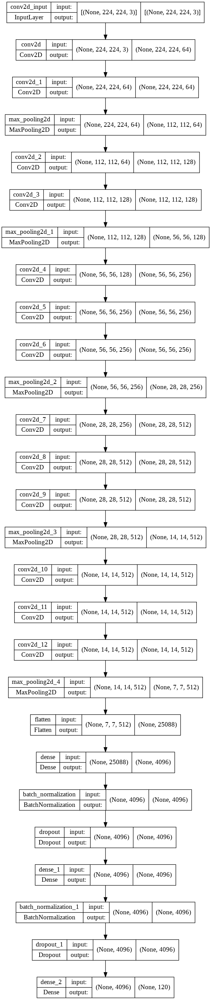

In [ ]:
# Save this architecture as an image 
tf.keras.utils.plot_model(model_VGG16_1, my_img_path + "/my_vgg16_model_1.png", 
                          show_shapes=True)

#### **Compilation du modèle**

In [ ]:
# Model compilation
model_VGG16_1.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**
Nous choisissons de modifier le early_stop en le mettant sur le loss du jeu de validation. En effet, d'après l'entrainement précédent, nous constatons que l'accuracy sur le jeu de validation varie très peu, contrairement au loss. Par ailleurs, Google Colab ne permet pas d'utiliser les ressources pendant un temps d'excécution très long.

Cela nous permet donc de gagner du temps. Nous indiquons une valeur de patience égale à 10.

In [ ]:
# File to save model
model_file_path = models_path + "/my_vgg16_model_1.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=10, 
                      verbose=1, 
                      mode='min')

#### **Entrainement du modèle**
Nous entrainons le modèle sur 100 epochs.

In [ ]:
%%time

epochs = 100

history = model_VGG16_1.fit(
                train_iterator,
                steps_per_epoch = train_size // BATCH_SIZE, #default value
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
419/419 [==============================] - ETA: 0s - loss: 7.1579 - accuracy: 0.0128
Epoch 1: val_accuracy improved from -inf to 0.00911, saving model to /content/drive/My Drive/Formation/Dog Classification/models/my_vgg16_model_1.h5
419/419 [==============================] - 3310s 8s/step - loss: 7.1579 - accuracy: 0.0128 - val_loss: 209099.3281 - val_accuracy: 0.0091
Epoch 2/100
419/419 [==============================] - ETA: 0s - loss: 7.0026 - accuracy: 0.0154
Epoch 2: val_accuracy improved from 0.00911 to 0.01302, saving model to /content/drive/My Drive/Formation/Dog Classification/models/my_vgg16_model_1.h5
419/419 [==============================] - 400s 954ms/step - loss: 7.0026 - accuracy: 0.0154 - val_loss: 3171595.0000 - val_accuracy: 0.0130
Epoch 3/100
419/419 [==============================] - ETA: 0s - loss: 6.8618 - accuracy: 0.0161
Epoch 3: val_accuracy did not improve from 0.01302
419/419 [==============================] - 384s 917ms/step - loss: 6.8618 - ac

#### **Visualisation des résultats**

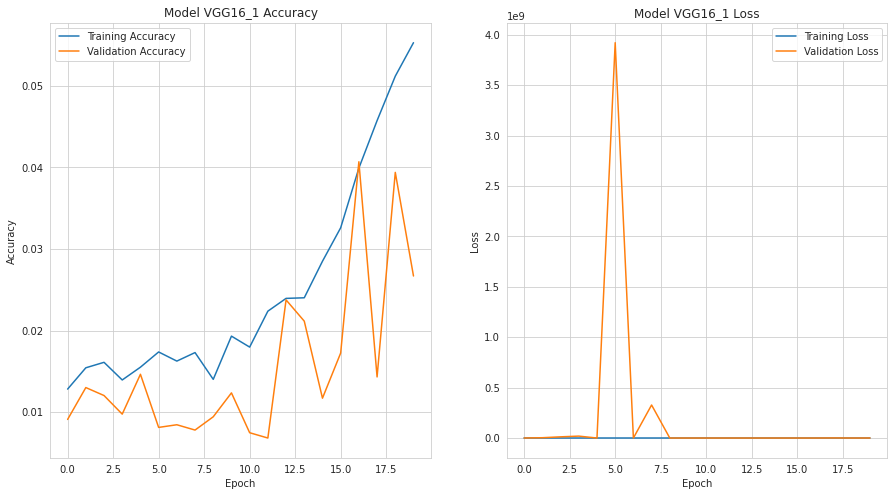

In [ ]:
plot_learning_curve(history, "Model VGG16_1")

L'entrainement s'est arrêté au bout de 20 epochs car le loss sur le jeu de validation ne diminuait plus depuis 10 epochs. 

Nous constatons par contre que l'accuracy continuait d'augmenter sur le jeu de validation.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False)

Found 4072 images belonging to 120 classes.


In [ ]:
# Model evaluation
model_VGG16_eval = model_VGG16_1.evaluate(test_iterator, steps=test_size // BATCH_SIZE)
print("Loss on test set = ", model_VGG16_eval[0])
print("Accuracy on test set = ",model_VGG16_eval[1])

127/127 [==============================] - 788s 6s/step - loss: 165117.0938 - accuracy: 0.0253
Loss on test set =  165117.09375
Accuracy on test set =  0.02534448727965355


Vu les mauvaises valeurs de Loss et d'Accuracy, le modèle n'a quasiment rien appris.

## **5. Data Augmentation**
D'après le site de Stanford, il y a environ 170 images par race de chien. Comme nous avons splitté les données, le modèle apprend en fait sur "seulement" moins d'une centaine d'images par race de chien. Cela est peu et nous pouvons envisager une data augmentation afin de fournir articiellement plus d'images au modèle pour son apprentissage. 

Nous allons appliquer la data augmentation avec ImageDataGenerator. En effet, avec cette classe de la bibliothèque Keras, les images sont augmentées en direct ("online") lors de l’entraînement du réseau. Elles ne sont donc jamais sauvegardées en mémoire, et le réseau ne rencontre jamais deux fois la même image (car ces augmentations sont aléatoires). Cette méthode permet de s’assurer que le réseau voit des images variées à chaque epoch (cycle d’entraînement complet). 

### **5.1. Visualisation des effets sur une image**

Nous testons les techniques suivantes sur une image pour voir les effets produits :
- effet miroir (horizontal_flip)
- rotation
- décalage (haut/bas et/ou droite/gauche)
- changement de luminosité
- zoom
- whitening

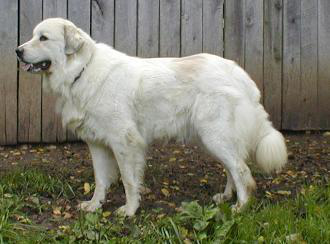

In [ ]:
# Image test
# Path to Great_Pyrenees breed file
img_path_train = train_path + "/n02111500-Great_Pyrenees"

# List of images
list_img_train = os.listdir(img_path_train)

# Path to one image
img_path = os.path.join(img_path_train,list_img_train[1])

# Display image
img = Image.open(img_path)
img

In [ ]:
SIZE = 224

# Resize image
img = img.resize((SIZE,SIZE))

# Array
img_array = np.array(img)
img_array = img_array.reshape((1,)+img_array.shape)

In [ ]:
def display_data_augmentation(datagen, img, img_array) :
  """
    Function to display effect of data augmentation on an image

    Arguments :
    - datagen : ImageDataGenerator
    - img : original image which has been resized
    - img_array : original image in array format

    Display :
    - 4 images : the original and three with data augmentation effect
  """
  # iterator
  aug_iter = datagen.flow(img_array, batch_size=1)

  # generate samples and plot
  fig = plt.figure(figsize=(15,15))

  # display original image
  plt.subplot(1,4,1)
  plt.imshow(img)
  plt.title("Original Image")

  # generate batch of images
  for i in range(3):
    plt.subplot(1,4,i+2)
    # convert to unsigned integers
    image = next(aug_iter)[0].astype("uint8")
	  # plot image
    plt.imshow(image)
    plt.title("Augmented Image #{}".format(i+1))

#### **Effet miroir**

Nous pouvons effectuer un effet miroir via un horizontal_flip ou vertical_flip. Nous ne retenons ici que l'horizontal_flip car le vertical_flip n'a de sens que pour des objets symétrique haut/bas (comme des ballons par exemple). En effet, nous n'avons pas besoin de chiens avec la tête à l'envers (excepté si le chien est couché sur son dos, ce qui n'est pas forcément une image courante...).

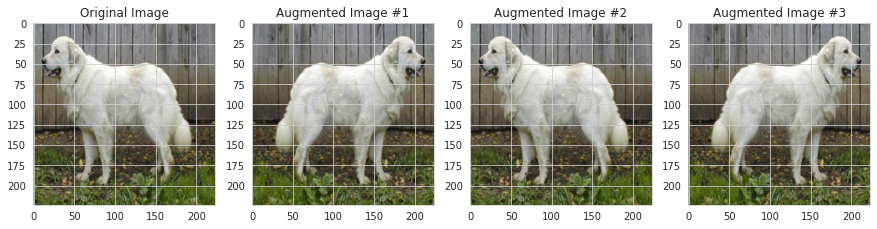

In [ ]:
# ImageDataGenerator flipping
datagen = ImageDataGenerator(horizontal_flip=True)

# Display effects
display_data_augmentation(datagen, img, img_array)

#### **Rotation**
Lorsque l'image pivote, certains pixels se déplacent en dehors de l'image et laissent une zone vide qui doit être remplie. Nous pouvons remplir ceci de différentes manières : valeur constante ou  valeurs de pixel les plus proches, etc. Ceci est spécifié dans l'argument fill_mode et la valeur par défaut est "le plus proche", qui remplace simplement la zone vide par les valeurs de pixel les plus proches.


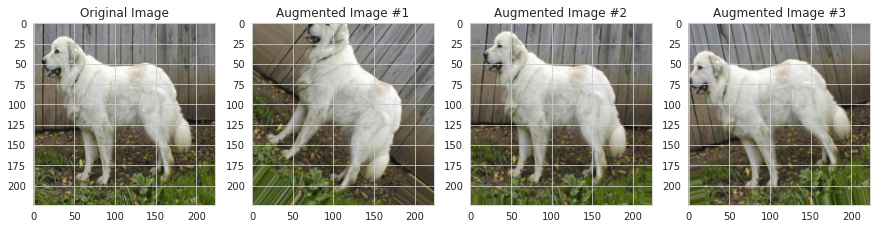

In [ ]:
# ImageDataGenerator rotation
datagen = ImageDataGenerator(rotation_range=45, fill_mode='nearest')

# Display effects
display_data_augmentation(datagen, img, img_array)

#### **Décalage**
Cette méthode est utile lorsque l'image n'est pas centrée. Nous pouvons décaler les pixels de l'image horizontalement ou verticalement ; cela se fait en ajoutant une certaine valeur constante à tous les pixels. 

Si la valeur est un float, cela indique le pourcentage de largeur ou hauteur de l'image à décaler. Si la valeur est integer, cela indique le nombre de pixels de décalage.

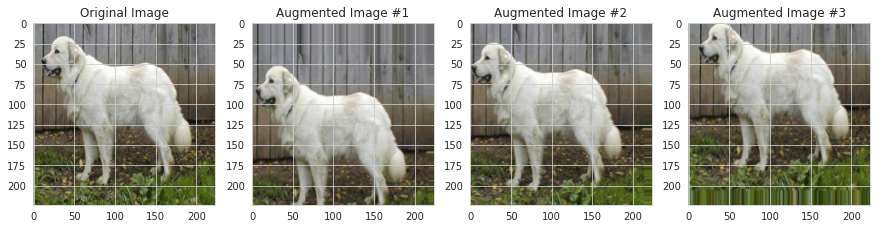

In [ ]:
# ImageDataGenerator shifting
datagen = ImageDataGenerator(width_shift_range=0.2, height_shift_range=0.2)

# Display effects
display_data_augmentation(datagen, img, img_array)

#### **Luminosité**
Cette méthode change la luminosité de l'image. Toutes les images n'étant pas prises sous un éclairage parfait, il est bien d'entrainer le modèle avec des images sous différentes conditions de lumière.

Nous indiquons un intervalle de luminosité : une valeur inférieure à 1 assombrit l'image et une valeur supérieure à 1 éclaircit l'image.

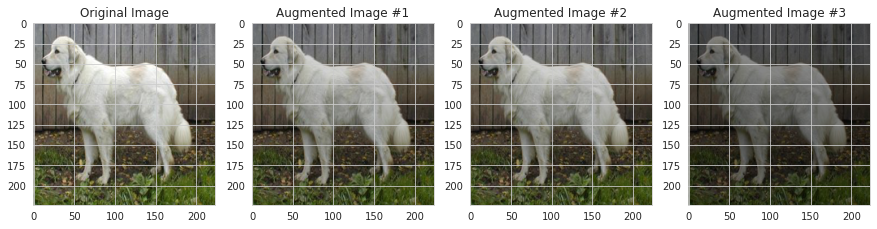

In [ ]:
# ImageDataGenerator brightness
datagen = ImageDataGenerator(brightness_range=[0.5,1.5])

# Display effects
display_data_augmentation(datagen, img, img_array)

#### **Zoom**
Cette méthode permet de faire un zoom in ou un zoom out de l'image. 

En indiquant un zoom_range sous forme de float, le zoom sera fait dans l'intervalle [1-zoom_range, 1+zoom_range]. Une valeur inférieure à 1 fait un zoom in et une valeur supérieure à 1 un zoom out.

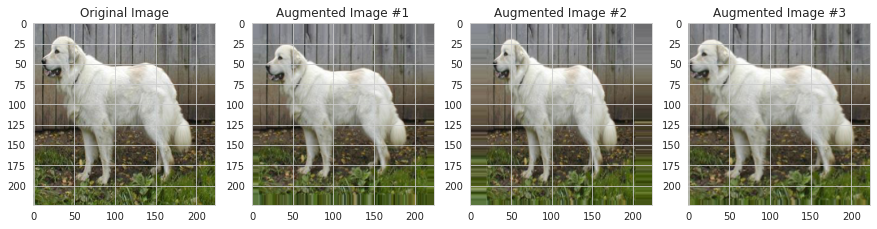

In [ ]:
# ImageDataGenerator zoom
datagen = ImageDataGenerator(zoom_range=0.25)

# Display effects
display_data_augmentation(datagen, img, img_array)

#### **Whitening**
Cette méthode est une opération d'algèbre linéaire qui réduit la redondance d'images de pixels dans la matrice. Moins de redondance dans l'image est destinée à mieux mettre en évidence les structures et les caractéristiques de l'image pour l'algorithme d'apprentissage.

Nous utilisons le whitening via ZCA (et non par PCA) car ZCA montre de meilleurs résultats et donne des images transformées qui conservent toutes les dimensions d'origine et contrairement à PCA, les images transformées résultantes ressemblent toujours à leurs originaux.

**Impossible à lancer**, a fait planter le kernel.

In [ ]:
# ImageDataGenerator whitening
datagen = ImageDataGenerator(zca_whitening=True)

datagen.fit(img_array)

# Display effects
display_data_augmentation(datagen, img, img_array)

#### **Combinaison des effets**

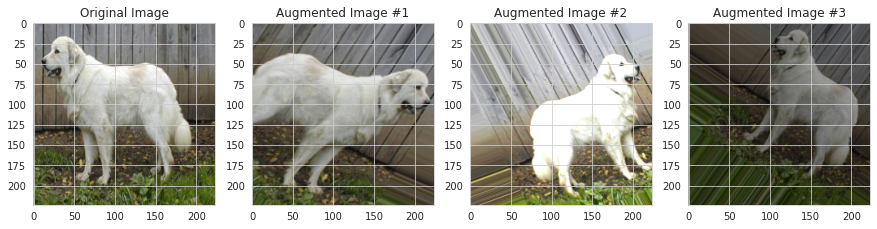

In [ ]:
# ImageDataGenerator
datagen = ImageDataGenerator(
        rotation_range=45, # rotation
        width_shift_range=0.2, # horizontal shift
        height_shift_range=0.2, # vertical shift
        zoom_range=0.25, # zoom
        horizontal_flip=True, # horizontal flip
        brightness_range=[0.5,1.5], # brightness
        ) 

# Display effects
display_data_augmentation(datagen, img, img_array)

### **5.2. Entrainement du modèle**


#### **Construction du modèle**
Nous repartons sur le modèle précédent.

In [ ]:
# Initialize the neural network
model_VGG16_2 = Sequential()

# Add Convolution Layers + Pooling Layers
# 1st convolution layer + ReLU
model_VGG16_2.add(Conv2D(input_shape=(224,224,3),filters=64,kernel_size=(3,3),
                       padding="same", activation="relu"))
# 2nd convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=64,kernel_size=(3,3),
                       padding="same", activation="relu"))
# 1st pooling layer
model_VGG16_2.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 3rd convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=128,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 4th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=128,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 2nd pooling layer
model_VGG16_2.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 5th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 6th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 7th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=256,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 3nd pooling layer
model_VGG16_2.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 8th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 9th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 10th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 4th pooling layer
model_VGG16_2.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
# 11th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 12th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 13th convolution layer + ReLU
model_VGG16_2.add(Conv2D(filters=512,kernel_size=(3,3), 
                       padding='same', activation='relu'))
# 5th pooling layer
model_VGG16_2.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

# Add Dense Layers
# Transform 3D matrix to 1D vector
model_VGG16_2.add(Flatten())
# 1st fully-connected layer + ReLU
model_VGG16_2.add(Dense(4096, activation='relu'))
# 1st BatchNormalization layer
model_VGG16_2.add(BatchNormalization())
# 1st Dropout layer
model_VGG16_2.add(Dropout(0.5))
# 2nd fully-connected layer + ReLU
model_VGG16_2.add(Dense(4096, activation='relu'))
# 2nd BatchNormalization layer
model_VGG16_2.add(BatchNormalization())
# 2nd Dropout layer
model_VGG16_2.add(Dropout(0.5))
# last fully-connected layer to classify the 120 breeds
model_VGG16_2.add(Dense(nb_breeds, activation='softmax'))

In [ ]:
model_VGG16_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 64)     0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 128)     73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 128)      0         
 2D)                                                    

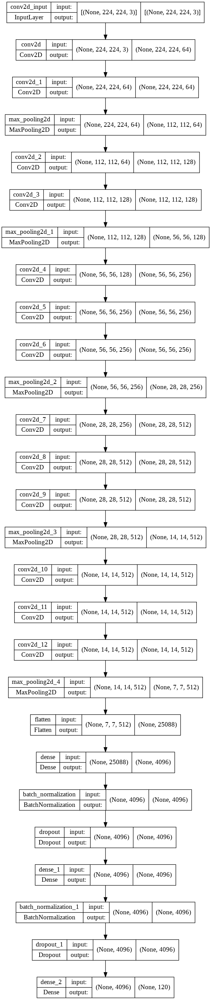

In [ ]:
# Save this architecture as an image 
tf.keras.utils.plot_model(model_VGG16_2, my_img_path + "/my_vgg16_model_2.png", 
                          show_shapes=True)

#### **Compilation du modèle**
Nous conservons l'optimizer `Adam`, ainsi que le même learning rate.

In [ ]:
# Model compilation
model_VGG16_2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**
Nous conservons le early_stop sur le loss du jeu de validation.

In [ ]:
# File to save model
model_file_path = models_path + "/my_vgg16_model_2.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=10, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**
Nous appliquons la data augmentation uniquement sur le jeu de train.

In [ ]:
# ImageDataGenerator
datagen_train = ImageDataGenerator(rescale=1./255,
        rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5])

datagen = ImageDataGenerator(rescale=1./255)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 13436 images belonging to 120 classes.
Found 3072 images belonging to 120 classes.


#### **Entrainement du modèle**
Nous entrainons sur 100 epochs.

In [ ]:
%%time

epochs = 100

history = model_VGG16_2.fit(
                train_iterator,
                steps_per_epoch = train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
419/419 [==============================] - ETA: 0s - loss: 7.1834 - accuracy: 0.0101
Epoch 1: val_accuracy improved from -inf to 0.01074, saving model to /content/drive/My Drive/Formation/Dog Classification/models/my_vgg16_model_2.h5
419/419 [==============================] - 437s 998ms/step - loss: 7.1834 - accuracy: 0.0101 - val_loss: 6619.6460 - val_accuracy: 0.0107
Epoch 2/100
419/419 [==============================] - ETA: 0s - loss: 7.0803 - accuracy: 0.0121
Epoch 2: val_accuracy improved from 0.01074 to 0.01270, saving model to /content/drive/My Drive/Formation/Dog Classification/models/my_vgg16_model_2.h5
419/419 [==============================] - 416s 991ms/step - loss: 7.0803 - accuracy: 0.0121 - val_loss: 6.4300 - val_accuracy: 0.0127
Epoch 3/100
419/419 [==============================] - ETA: 0s - loss: 6.8904 - accuracy: 0.0109
Epoch 3: val_accuracy did not improve from 0.01270
419/419 [==============================] - 396s 943ms/step - loss: 6.8904 - accuracy

#### **Visualisation des résultats**

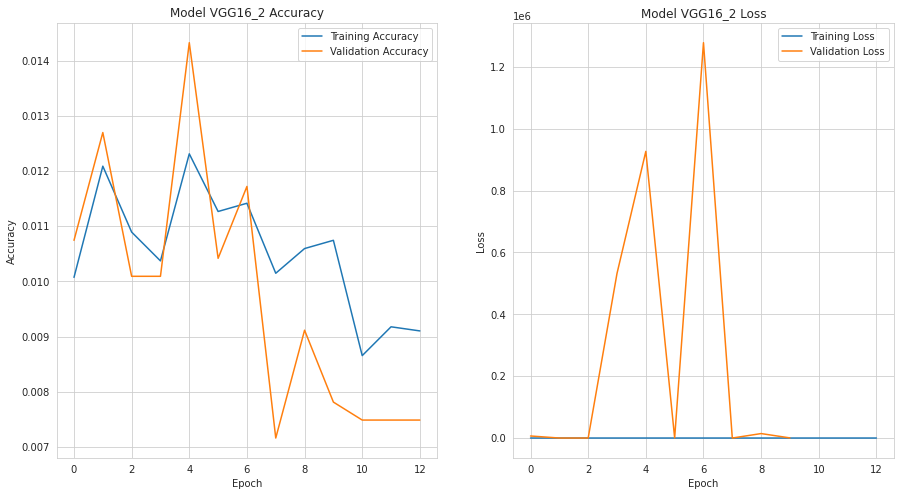

In [ ]:
plot_learning_curve(history, "Model VGG16_2")

L'entrainement s'est arrêté au bout de 12 epochs car le loss sur le jeu de validation ne diminuait plus depuis 10 epochs. 

Le modèle a du mal à apprendre avec la data augmentation.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 4072 images belonging to 120 classes.


In [ ]:
# Model evaluation
model_VGG16_eval = model_VGG16_2.evaluate(test_iterator, 
                                          steps=test_size // BATCH_SIZE)
print("Loss on test set = ", model_VGG16_eval[0])
print("Accuracy on test set = ",model_VGG16_eval[1])

127/127 [==============================] - 2303s 18s/step - loss: 1175788.1250 - accuracy: 0.0108
Loss on test set =  1175788.125
Accuracy on test set =  0.010826772078871727


Les résultats ne sont pas bons. Le modèle doit certainement avoir besoin de plus d'epochs d'entrainement.

## **6. Transfer Learning**
Dans cette partie, nous utilisons des réseaux déjà entrainés que nous adaptons à notre problème, notamment en modifiant les dernières couches.

Keras met à disposition [une liste des Keras Application](https://keras.io/api/applications/) (réseaux déjà entrainés) avec des informations sur ces applications (taille, nombre de paramètres, etc...). Nous choisissons les modèles suivants :
- VGG-16
- MobileNetV2
- ResNet50V2

Nous appliquons la même démarche pour ces 3 modèles.

### **6.1. VGG-16**
Ce modèle a été pré-entrainé sur ImageNet dont est issu le Stanford Dogs Dataset. Par conséquent, des features relatives aux chiens ont été apprises. 


#### **Importation du modèle**

In [ ]:
tf.keras.backend.clear_session()
from keras.applications.vgg16 import VGG16, preprocess_input 

# Model importation without fully connected layers
imported_VGG16 = VGG16(weights="imagenet", 
                       include_top=False, 
                       input_shape=(224,224,3))

# We train only last layers
for layer in imported_VGG16.layers:
    layer.trainable = False

imported_VGG16.summary()

58900480/58889256 [==============================] - 0s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

#### **Ajout des dernières couches**
Par souci de temps d'exécution, d'utilisation de GPU et de mémoire stockée, nous limitons les dernières couches à une couche de `GlobalAveragePooling2D`, `DropOut` et la couche de classification.

In [ ]:
nb_breeds = 120

# Get model output
x = imported_VGG16.output

# Add Dense layers
# Convert the feature vector into a 1280 element vector
x = GlobalAveragePooling2D()(x)
x = Dropout(0.5)(x)
# last fully-connected layer to classify the 120 breeds
predictions = Dense(nb_breeds, activation='softmax')(x)

# Model Building
new_model_VGG16 = Model(inputs = imported_VGG16.input, outputs=predictions)

new_model_VGG16.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

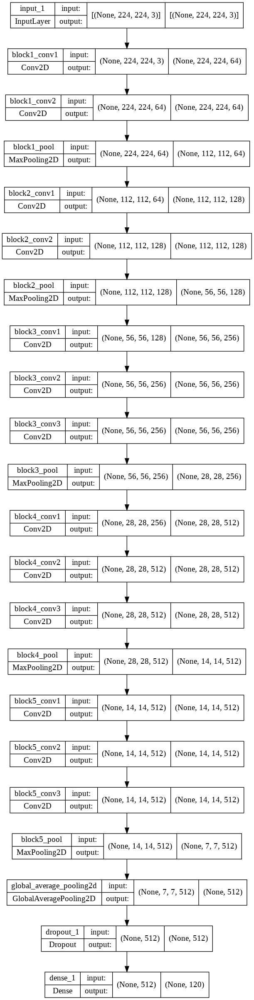

In [ ]:
# Save this architecture as an image 
tf.keras.utils.plot_model(new_model_VGG16, my_img_path + "/new_model_VGG16_bis.png", 
                          show_shapes=True)

#### **Compilation du modèle**

In [ ]:
# Model compilation
new_model_VGG16.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**
Nous indiquons une patience de 10.

In [ ]:
# File to save model
model_file_path = models_path + "/new_model_VGG16.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=10, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**

In [ ]:
# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 13436 images belonging to 120 classes.
Found 3072 images belonging to 120 classes.


#### **Entrainement du modèle**

In [ ]:
%%time

epochs = 100

history = new_model_VGG16.fit(
                train_iterator,
                steps_per_epoch = train_size // BATCH_SIZE, #default value
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
419/419 [==============================] - ETA: 0s - loss: 13.6099 - accuracy: 0.0736
Epoch 1: val_accuracy improved from -inf to 0.41081, saving model to /content/drive/My Drive/Formation/Dog Classification/models/new_model_VGG16.h5
419/419 [==============================] - 3490s 8s/step - loss: 13.6099 - accuracy: 0.0736 - val_loss: 3.8251 - val_accuracy: 0.4108
Epoch 2/100
419/419 [==============================] - ETA: 0s - loss: 7.1383 - accuracy: 0.2204
Epoch 2: val_accuracy improved from 0.41081 to 0.52995, saving model to /content/drive/My Drive/Formation/Dog Classification/models/new_model_VGG16.h5
419/419 [==============================] - 323s 770ms/step - loss: 7.1383 - accuracy: 0.2204 - val_loss: 2.7247 - val_accuracy: 0.5299
Epoch 3/100
419/419 [==============================] - ETA: 0s - loss: 5.4036 - accuracy: 0.3048
Epoch 3: val_accuracy improved from 0.52995 to 0.59538, saving model to /content/drive/My Drive/Formation/Dog Classification/models/new_mode

#### **Visualisation des résultats**

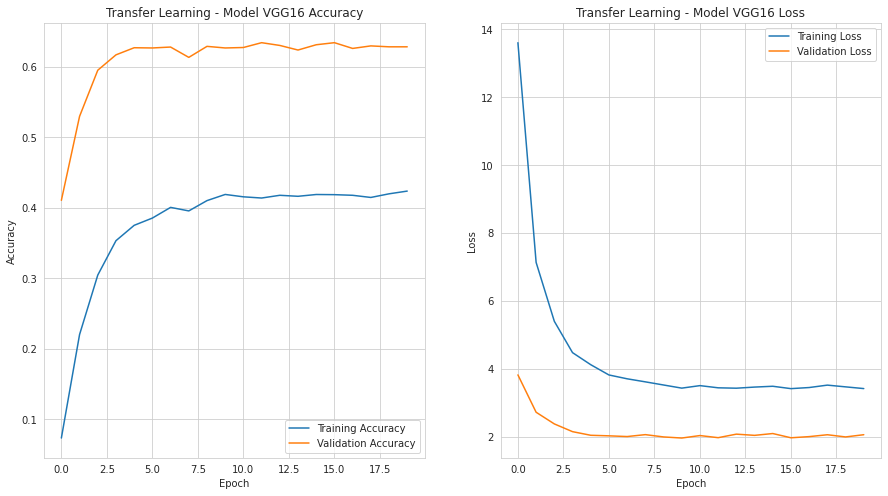

In [ ]:
plot_learning_curve(history, "Transfer Learning - Model VGG16")

La data augmentation faite uniquement sur le trainset impacte l'apprentissage : le modèle n'arrive plus à apprendre.

Par ailleurs, comme le jeu de validation n'a pas d'image augmentation, les valeurs d'accuracy et de loss y sont meilleures.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 4072 images belonging to 120 classes.


In [ ]:
# Model evaluation
model_VGG16_eval = new_model_VGG16.evaluate(test_iterator, 
                                          steps=test_size // BATCH_SIZE)
print("Loss on test set = ", model_VGG16_eval[0])
print("Accuracy on test set = ",model_VGG16_eval[1])

127/127 [==============================] - 2062s 16s/step - loss: 1.9192 - accuracy: 0.6169
Loss on test set =  1.9191654920578003
Accuracy on test set =  0.616879940032959


Ls valeurs sont nettement meilleures que celles des modèles from scratch.

### **6.2. MobileNetV2** 
Ce réseau est nettement plus "léger" que VGG-16 car il "ne fait que" 14M (entre 30 et 40 fois plus "petit" que VGG-16 ). Il contient environ 6 fois moins de paramètres que VGG-16 (23.9M vs 138.4M) et présente des performances pourtant similaires. Il a aussi été entrainé sur ImageNet.

Ce réseau est fait pour être utilisé sur des appareils mobiles.



#### **Importation du modèle**

In [ ]:
tf.keras.backend.clear_session()

from keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input

# Model importation without fully connected layers
imported_MobileNetV2 = MobileNetV2(weights="imagenet", 
                                   include_top=False, 
                                   input_shape=(224,224,3))

# We train only last layers
for layer in imported_MobileNetV2.layers:
    layer.trainable = False

imported_MobileNetV2.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                              

#### **Ajout des dernières couches**

In [ ]:
nb_breeds = 120

# Get model output
x = imported_MobileNetV2.output

# Convert the feature vector into a 1280 element vector
x = GlobalAveragePooling2D()(x)
# last fully-connected layer to classify the 120 breeds
predictions = Dense(nb_breeds, activation='softmax')(x)

# Model Building
new_model_MobileNetV2 = Model(inputs = imported_MobileNetV2.input, 
                              outputs = predictions)

new_model_MobileNetV2.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                             

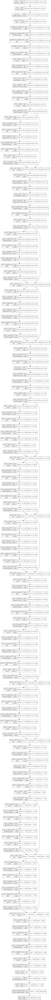

In [ ]:
# Save this architecture as an image 
tf.keras.utils.plot_model(new_model_MobileNetV2, 
                          my_img_path + "/new_model_MobileNetV2.png", 
                          show_shapes=True)

#### **Compilation du modèle**

In [ ]:
# Model compilation
new_model_MobileNetV2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**
Nous prenons ici une patience de 15.

In [ ]:
# File to save model
model_file_path = models_path + "/new_model_MobileNetV2.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=15, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**

In [ ]:
# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 13436 images belonging to 120 classes.
Found 3072 images belonging to 120 classes.


#### **Entrainement du modèle**

In [ ]:
%%time

epochs = 100

history = new_model_MobileNetV2.fit(
                train_iterator,
                steps_per_epoch = train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
419/419 [==============================] - ETA: 0s - loss: 2.0069 - accuracy: 0.4911
Epoch 1: val_accuracy improved from -inf to 0.76074, saving model to /content/drive/My Drive/Formation/Dog Classification/models/new_model_MobileNetV2.h5
419/419 [==============================] - 3535s 8s/step - loss: 2.0069 - accuracy: 0.4911 - val_loss: 0.8394 - val_accuracy: 0.7607
Epoch 2/100
419/419 [==============================] - ETA: 0s - loss: 1.1882 - accuracy: 0.6586
Epoch 2: val_accuracy improved from 0.76074 to 0.78320, saving model to /content/drive/My Drive/Formation/Dog Classification/models/new_model_MobileNetV2.h5
419/419 [==============================] - 685s 2s/step - loss: 1.1882 - accuracy: 0.6586 - val_loss: 0.7150 - val_accuracy: 0.7832
Epoch 3/100
419/419 [==============================] - ETA: 0s - loss: 1.0430 - accuracy: 0.6905
Epoch 3: val_accuracy improved from 0.78320 to 0.79362, saving model to /content/drive/My Drive/Formation/Dog Classification/models/n

#### **Visualisation des résultats**

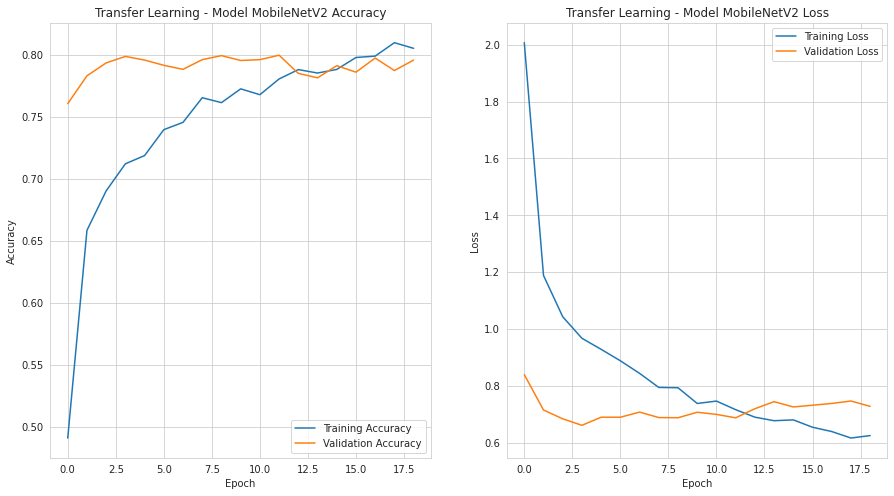

In [ ]:
plot_learning_curve(history, "Transfer Learning - Model MobileNetV2")

Le modèle n'a pas fini d'apprendre, mais déjà les valeurs d'accuracy et de loss sont meilleures que celles de VGG16.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 4072 images belonging to 120 classes.


In [ ]:
# Model evaluation
model_MobileNetV2_eval = new_model_MobileNetV2.evaluate(test_iterator, 
                                          steps=test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

127/127 [==============================] - 963s 8s/step - loss: 0.6931 - accuracy: 0.7943
Loss on test set =  0.6931472420692444
Accuracy on test set =  0.7942913174629211


L'accuracy est 30% meilleure que celle de VGG16.

### **6.3. ResNet50V2** 


#### **Importation du modèle**

In [ ]:
tf.keras.backend.clear_session()
from keras.applications.resnet_v2 import ResNet50V2, preprocess_input 

# Model importation without fully connected layers
imported_ResNet50V2 = ResNet50V2(weights="imagenet", 
                                   include_top=False, 
                                   input_shape=(224,224,3))

# We train only last layers
for layer in imported_ResNet50V2.layers:
    layer.trainable = False

imported_ResNet50V2.summary()

94683136/94668760 [==============================] - 1s 0us/step
Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                        

#### **Ajout des dernières couches**

In [ ]:
nb_breeds = 120

# Get model output
x = imported_ResNet50V2.output

# Additionnal layers
x = GlobalAveragePooling2D()(x)
x = Dropout(0.5)(x)
# last fully-connected layer to classify the 120 breeds
predictions = Dense(nb_breeds, activation='softmax')(x)

# Model Building
new_model_ResNet50V2 = Model(inputs = imported_ResNet50V2.input, 
                             outputs = predictions)

new_model_ResNet50V2.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

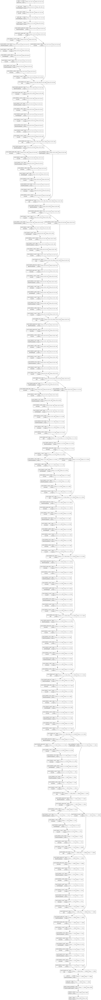

In [ ]:
# Save this architecture as an image 
tf.keras.utils.plot_model(new_model_ResNet50V2, 
                          my_img_path + "/new_model_ResNet50V2.png", 
                          show_shapes=True)

#### **Compilation du modèle**

In [ ]:
# Model compilation
new_model_ResNet50V2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**

In [ ]:
# File to save model
model_file_path = models_path + "/new_model_ResNet50V2.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=10, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**

In [ ]:
# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 13436 images belonging to 120 classes.
Found 3072 images belonging to 120 classes.


#### **Entrainement du modèle**

In [ ]:
%%time

epochs = 100

history = new_model_ResNet50V2.fit(
                train_iterator,
                steps_per_epoch = train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
419/419 [==============================] - ETA: 0s - loss: 2.9002 - accuracy: 0.3406
Epoch 1: val_accuracy improved from -inf to 0.67643, saving model to /content/drive/My Drive/Formation/Dog Classification/models/new_model_ResNet50V2.h5
419/419 [==============================] - 4176s 10s/step - loss: 2.9002 - accuracy: 0.3406 - val_loss: 1.1211 - val_accuracy: 0.6764
Epoch 2/100
419/419 [==============================] - ETA: 0s - loss: 1.8926 - accuracy: 0.5210
Epoch 2: val_accuracy improved from 0.67643 to 0.71875, saving model to /content/drive/My Drive/Formation/Dog Classification/models/new_model_ResNet50V2.h5
419/419 [==============================] - 302s 721ms/step - loss: 1.8926 - accuracy: 0.5210 - val_loss: 1.0173 - val_accuracy: 0.7188
Epoch 3/100
419/419 [==============================] - ETA: 0s - loss: 1.7503 - accuracy: 0.5586
Epoch 3: val_accuracy improved from 0.71875 to 0.72754, saving model to /content/drive/My Drive/Formation/Dog Classification/models

#### **Visualisation des résultats**

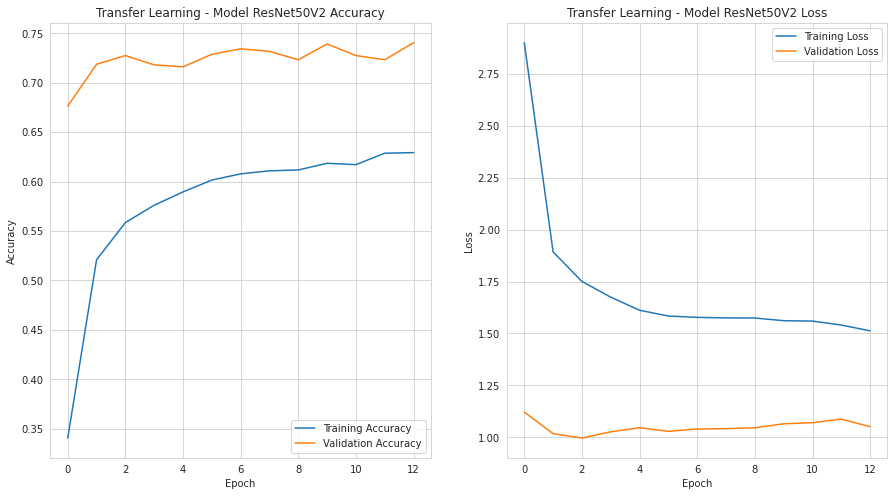

In [ ]:
plot_learning_curve(history, "Transfer Learning - Model ResNet50V2")

In [ ]:
# Convert the history.history dict to a pandas DataFrame:     
hist_df = pd.DataFrame(history.history) 

# Save to csv: 
hist_csv_file = models_path + "/history_ResNet50V2.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 4072 images belonging to 120 classes.


In [ ]:
# Model evaluation
model_ResNet50V2_eval = new_model_ResNet50V2.evaluate(test_iterator, 
                                          steps=test_size // BATCH_SIZE)
print("Loss on test set = ", model_ResNet50V2_eval[0])
print("Accuracy on test set = ",model_ResNet50V2_eval[1])

127/127 [==============================] - 880s 7s/step - loss: 1.0339 - accuracy: 0.7347
Loss on test set =  1.0339351892471313
Accuracy on test set =  0.7347440719604492


L'accuracy est meilleure que celle de VGG16 mais inférieure à celle de MobileNetV2.

## **7. Réduction du dataset et MobileNetV2**
Suite à des problèmes de connexion internet et des temps de GPU alloués courts, nous choisissons de restreindre le dataset à 12 races, parmi les préférées de français (d'après le lien [ici](https://www.centrale-canine.fr/actualites/lof-2021-les-races-de-chiens-preferees-des-francais)).

Afin de poursuivre le travail d'amélioration d'un modèle pré-entrainé, nous travaillons désormais avec MobileNetV2 car ce modèle est "léger" et assez performant.

### **7.1. Split du dataset**
Nous utilisons la même technique que précédemment pour splitter les données, en restreignant à 12 races.

In [ ]:
images_dir_path = '/content/drive/My Drive/Formation/Dog Classification'
data_rep = os.path.join(images_dir_path,'data')

# Create repository to put data
breeds12_data_rep = os.path.join(images_dir_path,'breeds12_data')
os.makedirs(breeds12_data_rep, exist_ok=True)

# Path to the breed files
breed_files_path = os.path.join(data_rep,'Images')

# Breed list of directories
list_breed = os.listdir(breed_files_path)

In [ ]:
# Define list with 12 breeds
breeds12_list = [
    'n02096294-Australian_terrier',
    'n02093256-Staffordshire_bullterrier',
    'n02099601-golden_retriever',
    'n02106662-German_shepherd',
    'n02099712-Labrador_retriever',
    'n02088364-beagle',
    'n02100735-English_setter',
    'n02102318-cocker_spaniel',
    'n02105162-malinois',
    'n02093428-American_Staffordshire_terrier',
    'n02108915-French_bulldog',
    'n02101388-Brittany_spaniel']

In [ ]:
# Directories creation to put images inside
breeds12_train_path = breeds12_data_rep + "/Train_set"
os.makedirs(breeds12_train_path, exist_ok=True)

breeds12_validation_path = breeds12_data_rep + "/Validation_set"
os.makedirs(breeds12_validation_path, exist_ok=True)

breeds12_test_path = breeds12_data_rep + "/Test_set"
os.makedirs(breeds12_test_path, exist_ok=True)

Nous répartissons les images dans les différents répertoires pour créer les datasets.

In [ ]:
# Count total nb of images
breeds12_nb_tot_img = 0

# Threshold for each set
validation_threshold = 0.65
test_threshold = validation_threshold + 0.15

# Initiate size of datasets
breeds12_train_size = 0
breeds12_validation_size = 0
breeds12_test_size = 0

for file in breeds12_list :
    
    # Get path to the breed file
    file_path = os.path.join(breed_files_path, file)
    
    # Create path access and directory for each dataset
    breed_train_path = os.path.join(breeds12_train_path, file)
    os.makedirs(breed_train_path, exist_ok=True)
    breed_validation_path = os.path.join(breeds12_validation_path, file)
    os.makedirs(breed_validation_path, exist_ok=True)
    breed_test_path = os.path.join(breeds12_test_path, file)
    os.makedirs(breed_test_path, exist_ok=True)
    
    # Get list of images
    list_img = os.listdir(file_path)
    
    # Get index for datasets with ceil method (Smallest integer not less than x)
    breed_validation_threshold = math.ceil(len(list_img) * validation_threshold)
    breed_test_threshold = math.ceil(len(list_img) * test_threshold)
    
    # List of images for each dataset
    breed_train_set = list_img[:breed_validation_threshold]
    breed_validation_set = list_img[
      breed_validation_threshold:breed_test_threshold]
    breed_test_set = list_img[breed_test_threshold:len(list_img)]
    
    # For each "breed_train_set", get number of images = train_size
    # and copy it in right directory
    for img in breed_train_set :
        breeds12_train_size += 1
        breeds12_nb_tot_img += 1
        # Copy image in folder
        source = os.path.join(file_path, img)
        destination = os.path.join(breed_train_path, img)
        dest = shutil.copy(source, destination)
    
    # For each "breed_validation_set", get number of images = validation_size
    # and copy it in right directory
    for img in breed_validation_set :
        breeds12_validation_size += 1
        breeds12_nb_tot_img += 1
        # Copy image in folder
        source = os.path.join(file_path, img)
        destination = os.path.join(breed_validation_path, img)
        dest = shutil.copy(source, destination)

    # For each "breed_test_set", get number of images = test_size
    # and copy it in right directory
    for img in breed_test_set :
        breeds12_test_size += 1
        breeds12_nb_tot_img += 1
        # Copy image in folder
        source = os.path.join(file_path, img)
        destination = os.path.join(breed_test_path, img)
        dest = shutil.copy(source, destination)

print("Number of images in train set : ",breeds12_train_size)
print("Number of images in validation set : ",breeds12_validation_size)
print("Number of images in test set : ",breeds12_test_size)

# Check if every image has been affected to a dataset
if (breeds12_train_size + breeds12_validation_size + breeds12_test_size) == breeds12_nb_tot_img :
    print("\nImages distribution is successful")
else :
    print("Bad distribution, retry")

Number of images in train set :  1282
Number of images in validation set :  293
Number of images in test set :  389

Images distribution is successful


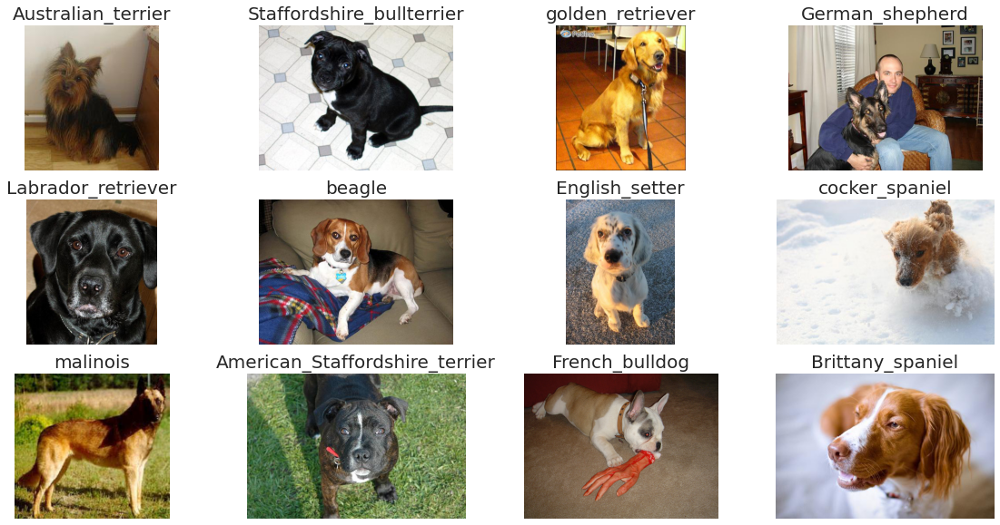

In [ ]:
# Display one animal for each breed
plt.figure(figsize=(20, 10))
for i in range(12):
    ax = plt.subplot(3, 4, i + 1)
    plt.title("{}".format(breeds12_list[i].split("-")[-1]), 
                 fontsize=20)
    images = os.listdir(breeds12_train_path + "/" + breeds12_list[i])
    x = np.random.randint(0, len(images))
    img = Image.open(
        breeds12_train_path + "/" + breeds12_list[i] +  "/" + images[x])
    plt.imshow(img)
    plt.axis("off")

### **7.2. Création du réseau**

#### **Construction**
Nous créons le réseau MobileNetV2 de zéro : le [site suivant](https://medium.com/analytics-vidhya/creating-mobilenetsv2-with-tensorflow-from-scratch-c85eb8605342) décrit en détail comment l'implémenter.


Voici l'architecture du réseau ([source](https://export.arxiv.org/pdf/1801.04381)) :

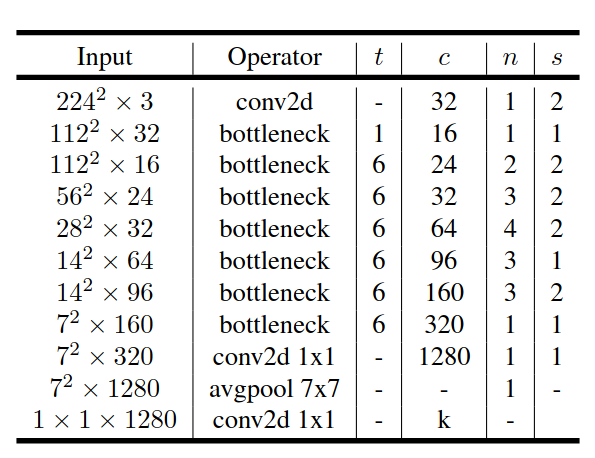

La spécificité de ce réseau est la présence d'un bloc de convolution appelé Inverted Residuals and Linear Bottlenecks. Dans ce bloc, les features d'une représentation dimensionnelle inférieure sont mises à l'échelle. Ensuite, une convolution en profondeur est appliquée, puis les features sont compressées dans la représentation dimensionnelle inférieure précédente.

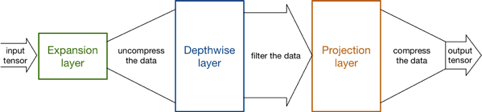

In [ ]:
# Creation of these layers
def expansion_block(x, t, filters, block_id):
    prefix = 'block_{}_'.format(block_id)
    total_filters = t*filters
    x = Conv2D(total_filters,1,padding='same',use_bias=False, 
               name = prefix +'expand')(x)
    x = BatchNormalization(name=prefix +'expand_bn')(x)
    x = ReLU(6,name = prefix +'expand_relu')(x)
    return x

def depthwise_block(x,stride,block_id):
    prefix = 'block_{}_'.format(block_id)
    x = DepthwiseConv2D(3,strides=(stride,stride),padding ='same', 
                        use_bias = False, name = prefix + 'depthwise_conv')(x)
    x = BatchNormalization(name=prefix +'dw_bn')(x)
    x = ReLU(6,name = prefix +'dw_relu')(x)
    return x
    
def projection_block(x,out_channels,block_id):
    prefix = 'block_{}_'.format(block_id)
    x = Conv2D(filters=out_channels,kernel_size = 1,padding='same',
               use_bias=False,name= prefix + 'compress')(x)
    x = BatchNormalization(name=prefix +'compress_bn')(x)
    return x

Puisque c'est un bloc résiduel, un ajout doit être effectué : la couche ajoutée est donc l'entrée et la sortie du bloc. L'intuition derrière les residuals est qu'elle crée une autoroute entre la première et la dernière couche, facilitant le flux de données, c'est-à-dire les gradients.
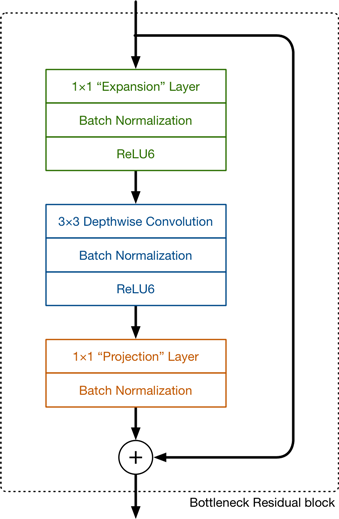

In [ ]:
# Creation of Bottleneck
def Bottleneck(x,t,filters, out_channels,stride,block_id):
  y = expansion_block(x,t,filters,block_id)
  y = depthwise_block(y,stride,block_id)
  y = projection_block(y, out_channels,block_id)
  if y.shape[-1]==x.shape[-1]:
    y = add([x,y])
  return y

In [ ]:
# Model creation
def MobileNetV2(input_image , n_classes):
  input = Input(input_image)

  x = Conv2D(32,3,strides=(2,2),padding='same', use_bias=False)(input)
  x = BatchNormalization(name='conv1_bn')(x)
  x = ReLU(6, name='conv1_relu')(x)

  # 17 Bottlenecks
  x = Bottleneck(x, t = 1, filters = x.shape[-1], out_channels = 16, 
                   stride = 1,block_id = 1)
    
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 24, 
                   stride = 2,block_id = 2)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 24, 
                   stride = 1,block_id = 3)
    
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 32, 
                   stride = 2,block_id = 4)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 32, 
                   stride = 1,block_id = 5)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 32, 
                   stride = 1,block_id = 6)
    
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 64, 
                   stride = 2,block_id = 7)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 64, 
                   stride = 1,block_id = 8)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 64, 
                   stride = 1,block_id = 9)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 64, 
                   stride = 1,block_id = 10)
    
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 96, 
                   stride = 1,block_id = 11)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 96, 
                   stride = 1,block_id = 12)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 96, 
                   stride = 1,block_id = 13)
    
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 160, 
                   stride = 2,block_id = 14)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 160, 
                   stride = 1,block_id = 15)
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 160, 
                   stride = 1,block_id = 16)
    
  x = Bottleneck(x, t = 6, filters = x.shape[-1], out_channels = 320, 
                   stride = 1,block_id = 17)
    
  # 1*1 convolution
  x = Conv2D(filters = 1280,kernel_size = 1,padding='same',use_bias=False, 
               name = 'last_conv')(x)
  x = BatchNormalization(name='last_bn')(x)
  x = ReLU(6,name='last_relu')(x)

  # AvgPool 7*7
  x = GlobalAveragePooling2D(name='global_average_pool')(x)

  output = Dense(n_classes,activation='softmax')(x)

  model = Model(input, output)

  return model

#### **Entrainement sans Data Augmentation**
Comme nous avons fait avec le modèle VGG16, nous entrainons le modèle from scratch sans data augmentation dans un premier temps.

In [ ]:
# Creation of our model
nb_breeds = 12
my_model_MobileNetV2 = MobileNetV2(input_image = (224,224,3), 
                                   n_classes = nb_breeds)
my_model_MobileNetV2.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_4 (Conv2D)              (None, 112, 112, 32  864         ['input_5[0][0]']                
                                )                                                                 
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 112, 112, 32  128         ['conv2d_4[0][0]']               
                                )                                                           

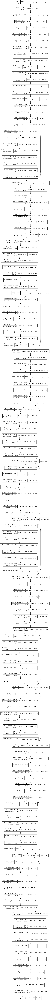

In [ ]:
# Create repository to save images
breeds12_my_img_path = os.path.join(breeds12_data_rep, "my_images")
os.makedirs(breeds12_my_img_path, exist_ok=True)

# Save this architecture as an image 
tf.keras.utils.plot_model(my_model_MobileNetV2, 
                          breeds12_my_img_path + "/my_model_MobileNetV2.png", 
                          show_shapes=True)

##### ***Compilation du modèle***

In [ ]:
# Model compilation
my_model_MobileNetV2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

##### ***Callbacks***

In [ ]:
breeds12_models_path = os.path.join(breeds12_data_rep, "models")

# File to save model
breeds12_model_file_path = breeds12_models_path + "/my_model_MobileNetV2.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_accuracy', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='max')

##### ***Pré-traitements des images***
Nous effectuons uniquement un rescale.

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 32

# Create data generator
datagen = ImageDataGenerator(rescale=1./255)

# Create iterator for trainset
train_iterator = datagen.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


##### ***Entrainement du modèle***
Nous entrainons le modèle sur 100 epochs

In [ ]:
%%time

epochs = 100
breeds12_train_size = 1282
breeds12_validation_size = 293

history = my_model_MobileNetV2.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
39/40 [============================>.] - ETA: 0s - loss: 2.6819 - accuracy: 0.0978
Epoch 1: val_accuracy improved from -inf to 0.07639, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/my_model_MobileNetV2.h5
40/40 [==============================] - 18s 328ms/step - loss: 2.6809 - accuracy: 0.0984 - val_loss: 2.4935 - val_accuracy: 0.0764
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 2.6318 - accuracy: 0.1016
Epoch 2: val_accuracy improved from 0.07639 to 0.10069, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/my_model_MobileNetV2.h5
40/40 [==============================] - 12s 304ms/step - loss: 2.6318 - accuracy: 0.1016 - val_loss: 2.5322 - val_accuracy: 0.1007
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 2.5101 - accuracy: 0.1296
Epoch 3: val_accuracy did not improve from 0.10069
40/40 [==============================] - 11s 276ms/step - loss:

In [ ]:
# Convert the history.history dict to a pandas DataFrame  
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_my_MobileNetV2.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

##### ***Visualisation des résultats***

In [ ]:
def plot_learning_curve(history, model) :
  """
    Function to plot learning curve

    Arguments :
    - history

    Display :
    - 2 graphs : one for the accuray and the other one for the loss
  """

  # Figure initialisation
  f, axes = plt.subplots(figsize=(15, 8))

  # Accuracy visualization
  plt.subplot(121)
  plt.plot(history.history['accuracy'], label="Training Accuracy")
  plt.plot(history.history['val_accuracy'], label="Validation Accuracy")
  plt.ylabel("Accuracy")
  plt.xlabel("Epoch")
  plt.legend()
  plt.title("{} Accuracy".format(model))

  # Loss visualization
  plt.subplot(122)
  plt.plot(history.history['loss'], label="Training Loss")
  plt.plot(history.history['val_loss'], label="Validation Loss")
  plt.title("{} Loss".format(model))
  plt.ylabel("Loss")
  plt.xlabel("Epoch")
  plt.legend()
  plt.show()

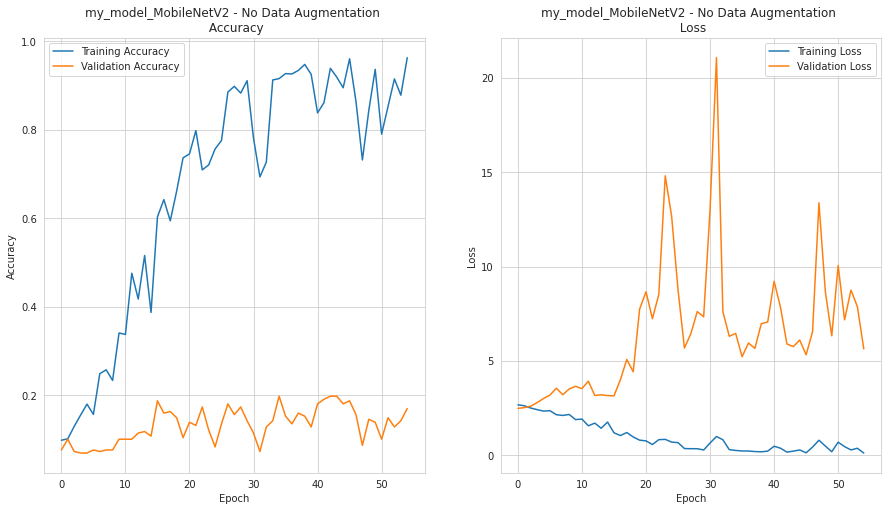

In [ ]:
plot_learning_curve(history, "my_model_MobileNetV2 - No Data Augmentation \n")

L'apprentissage s'est arrêté au bout de 55 epochs car le loss sur le jeu de validation ne diminuait plus. Nous voyons que le modèle n'a pas fini d'apprendre.



##### ***Evaluation du modèle***
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical')

Found 389 images belonging to 12 classes.


In [ ]:
breeds12_test_size = 389

# Model evaluation
model_MobileNetV2_eval = my_model_MobileNetV2.evaluate(
    test_iterator, steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

12/12 [==============================] - 77s 7s/step - loss: 5.9157 - accuracy: 0.1510
Loss on test set =  5.915708065032959
Accuracy on test set =  0.1510416716337204


L'accuracy est faible, le modèle a peu le temps d'apprendre.

#### **Entrainement avec Data Augmentation**
Comme nous avons fait avec le modèle VGG16, nous entrainons maintenant le modèle from scratch avec data augmentation.

In [ ]:
tf.keras.backend.clear_session()

# Creation of our model
nb_breeds = 12
my_model_MobileNetV2_2 = MobileNetV2(input_image = (224,224,3), 
                                   n_classes = nb_breeds)

##### ***Compilation du modèle***

In [ ]:
# Model compilation
my_model_MobileNetV2_2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

##### ***Callbacks***

In [ ]:
breeds12_models_path = os.path.join(breeds12_data_rep, "models")

# File to save model
breeds12_model_file_path = breeds12_models_path + "/my_model_MobileNetV2_2.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_accuracy', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='max')

##### ***Pré-traitements des images***
Nous effectuons une data augmentation comme dans les parties précédentes.

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 32

# ImageDataGenerator
datagen_train = ImageDataGenerator(rescale=1./255,
                                   rotation_range=45, 
                                   width_shift_range=0.2, 
                                   height_shift_range=0.2, 
                                   zoom_range=0.25, 
                                   horizontal_flip=True, 
                                   brightness_range=[0.5,1.5],
                                   fill_mode = "nearest")

datagen = ImageDataGenerator(rescale=1./255)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


##### ***Entrainement du modèle***
Nous entrainons le modèle sur 100 epochs

In [ ]:
%%time

epochs = 100
breeds12_train_size = 1282
breeds12_validation_size = 293

history = my_model_MobileNetV2_2.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
40/40 [==============================] - ETA: 0s - loss: 2.6877 - accuracy: 0.1016
Epoch 1: val_accuracy improved from -inf to 0.08333, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/my_model_MobileNetV2_2.h5
40/40 [==============================] - 41s 901ms/step - loss: 2.6877 - accuracy: 0.1016 - val_loss: 2.5075 - val_accuracy: 0.0833
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 2.6028 - accuracy: 0.0936
Epoch 2: val_accuracy did not improve from 0.08333
40/40 [==============================] - 28s 708ms/step - loss: 2.6028 - accuracy: 0.0936 - val_loss: 2.5457 - val_accuracy: 0.0799
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 2.5518 - accuracy: 0.0928
Epoch 3: val_accuracy did not improve from 0.08333
40/40 [==============================] - 29s 712ms/step - loss: 2.5518 - accuracy: 0.0928 - val_loss: 2.6056 - val_accuracy: 0.0764
Epoch 4/100
40/40 [=============================

In [ ]:
# Convert the history.history dict to a pandas DataFrame  
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_my_MobileNetV2_2.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

##### ***Visualisation des résultats***

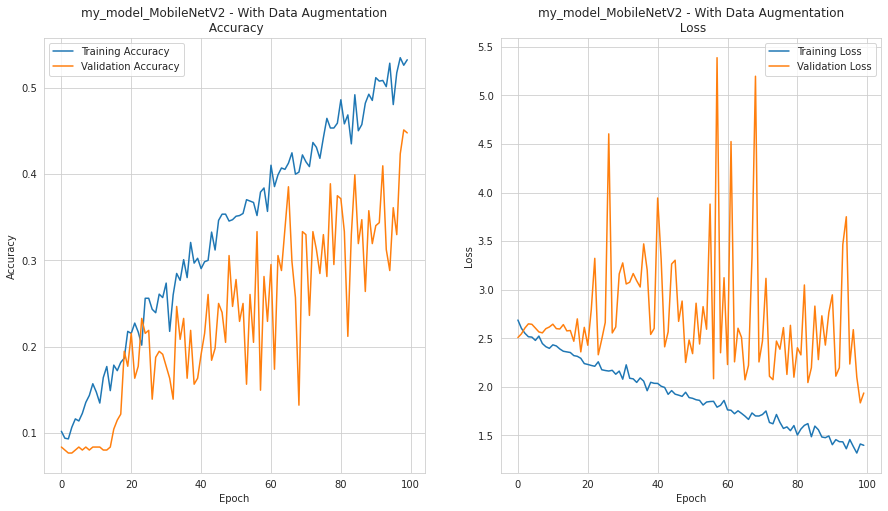

In [ ]:
plot_learning_curve(history, "my_model_MobileNetV2 - With Data Augmentation\n")

L'apprentissage est arrivé au bout des 100 epochs et il n'est pas terminé. Le modèle pouvait continuer à apprendre.



##### ***Evaluation du modèle***
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical')

Found 389 images belonging to 12 classes.


In [ ]:
breeds12_test_size = 389

# Model evaluation
model_MobileNetV2_eval = my_model_MobileNetV2_2.evaluate(
    test_iterator, steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("nAccuracy on test set = ",model_MobileNetV2_eval[1])

12/12 [==============================] - 2s 181ms/step - loss: 1.9079 - accuracy: 0.4349
Loss on test set =  1.907924771308899
nAccuracy on test set =  0.4348958432674408


Nous obtenons de meilleurs résultats que sans data augmentation. Cela peut s'expliquer par un plus grand nombre d'epochs pour l'apprentissage.

### **7.3. Transfer Learning avec Data Augmentation et couche `GlobalAveragePooling2D`** 
Dans un premier temps, nous mettons parmi les dernières couches une `GlobalAveragePooling2D`.



#### **Importation du modèle**

In [ ]:
tf.keras.backend.clear_session()

from keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input

# Model importation without fully connected layers
imported_MobileNetV2 = MobileNetV2(weights="imagenet", 
                                   include_top=False, 
                                   input_shape=(224,224,3))

# We train only last layers
for layer in imported_MobileNetV2.layers:
    layer.trainable = False

imported_MobileNetV2.summary()

9420800/9406464 [==============================] - 0s 0us/step
Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                

#### **Ajout des dernières couches**

In [ ]:
nb_breeds = 12

# Get model output
x = imported_MobileNetV2.output

# Convert the feature vector into a 1280 element vector
x = GlobalAveragePooling2D()(x)
# last fully-connected layer to classify the 12 breeds
predictions = Dense(nb_breeds, activation='softmax')(x)

# Model Building
new_model_MobileNetV2 = Model(inputs = imported_MobileNetV2.input, 
                              outputs = predictions)

new_model_MobileNetV2.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                             

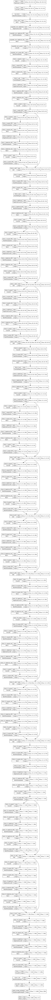

In [ ]:
# Save this architecture as an image 
tf.keras.utils.plot_model(new_model_MobileNetV2, 
                          breeds12_my_img_path + "/new_model_MobileNetV2.png", 
                          show_shapes=True)

#### **Compilation du modèle**

In [ ]:
# Model compilation
new_model_MobileNetV2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**

In [ ]:
# File to save model
breeds12_model_file_path = breeds12_models_path + "/new_model_MobileNetV2.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 32

# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        fill_mode = "nearest",
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


#### **Entrainement du modèle**

In [ ]:
%%time

epochs = 100

history = new_model_MobileNetV2.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
40/40 [==============================] - ETA: 0s - loss: 1.7511 - accuracy: 0.4376
Epoch 1: val_accuracy improved from -inf to 0.80903, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/new_model_MobileNetV2.h5
40/40 [==============================] - 39s 659ms/step - loss: 1.7511 - accuracy: 0.4376 - val_loss: 0.7096 - val_accuracy: 0.8090
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 0.7144 - accuracy: 0.7920
Epoch 2: val_accuracy improved from 0.80903 to 0.89236, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/new_model_MobileNetV2.h5
40/40 [==============================] - 30s 745ms/step - loss: 0.7144 - accuracy: 0.7920 - val_loss: 0.4207 - val_accuracy: 0.8924
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 0.5622 - accuracy: 0.8208
Epoch 3: val_accuracy did not improve from 0.89236
40/40 [==============================] - 33s 835ms/step - los

In [ ]:
# Convert the history.history dict to a pandas DataFrame  
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_MobileNetV2.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

#### **Visualisation des résultats**

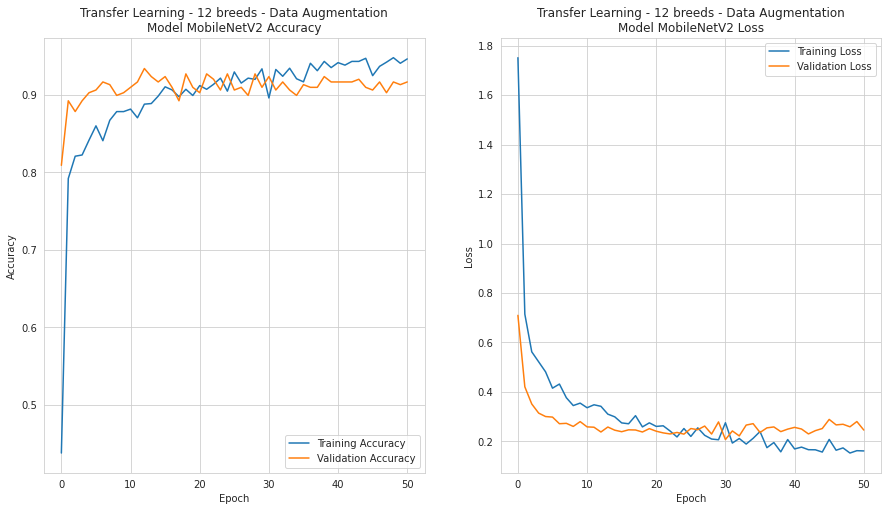

In [ ]:
plot_learning_curve(
    history, 
    "Transfer Learning - 12 breeds - Data Augmentation\nModel MobileNetV2"
    )

Nous voyons que le modèle apprend mieux et plus vite malgré la data augmentation. Passé les 25 epochs, les metrics sur le jeu de train sont supérieures, le modèle commençant à overfitter.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
# Model evaluation
model_MobileNetV2_eval = new_model_MobileNetV2.evaluate(test_iterator, 
                                          steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

12/12 [==============================] - 2s 178ms/step - loss: 0.3116 - accuracy: 0.8880
Loss on test set =  0.31163135170936584
Accuracy on test set =  0.8880208134651184


Nous obtenons des valeurs très satisfaisantes pour un premier essai sans optimisation.

### **7.4. Transfer Learning SANS Data Augmentation et couche `GlobalAveragePooling2D`** 

#### **Construction du modèle**

In [ ]:
nb_breeds = 12

def create_model(nb_breeds) :
  """
    Function to create model from imported MobileNetV2 with last layers
    modified with GlobalAveragePooling2D and Dense

    Arguments :
    - nb_breeds : number of breeds to consider (= number of classes)

    Return :
    - model of MobileNetV2 with last layers modified
  """

  # Get model output
  x = imported_MobileNetV2.output

  # Convert the feature vector into a 1280 element vector
  x = GlobalAveragePooling2D()(x)
  # last fully-connected layer to classify the 12 breeds
  predictions = Dense(nb_breeds, activation='softmax')(x)

  # Model Building
  return Model(inputs = imported_MobileNetV2.input, 
                              outputs = predictions)

In [ ]:
new_model_MobileNetV2_2 = create_model(nb_breeds)

#### **Compilation du modèle**

In [ ]:
# Model compilation
new_model_MobileNetV2_2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**

In [ ]:
# File to save model
breeds12_model_file_path = breeds12_models_path + "/new_model_MobileNetV2_2.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 32

# ImageDataGenerator
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


#### **Entrainement du modèle**

In [ ]:
%%time

epochs = 100

history = new_model_MobileNetV2_2.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
40/40 [==============================] - ETA: 0s - loss: 1.2375 - accuracy: 0.6120
Epoch 1: val_accuracy improved from -inf to 0.84028, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/new_model_MobileNetV2_2.h5
40/40 [==============================] - 19s 412ms/step - loss: 1.2375 - accuracy: 0.6120 - val_loss: 0.5232 - val_accuracy: 0.8403
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 0.3712 - accuracy: 0.8984
Epoch 2: val_accuracy improved from 0.84028 to 0.88542, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/new_model_MobileNetV2_2.h5
40/40 [==============================] - 17s 413ms/step - loss: 0.3712 - accuracy: 0.8984 - val_loss: 0.3282 - val_accuracy: 0.8854
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 0.2662 - accuracy: 0.9256
Epoch 3: val_accuracy improved from 0.88542 to 0.89583, saving model to /content/drive/My Drive/Formation/Do

In [ ]:
# Convert the history.history dict to a pandas DataFrame 
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_MobileNetV2_2.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

#### **Visualisation des résultats**

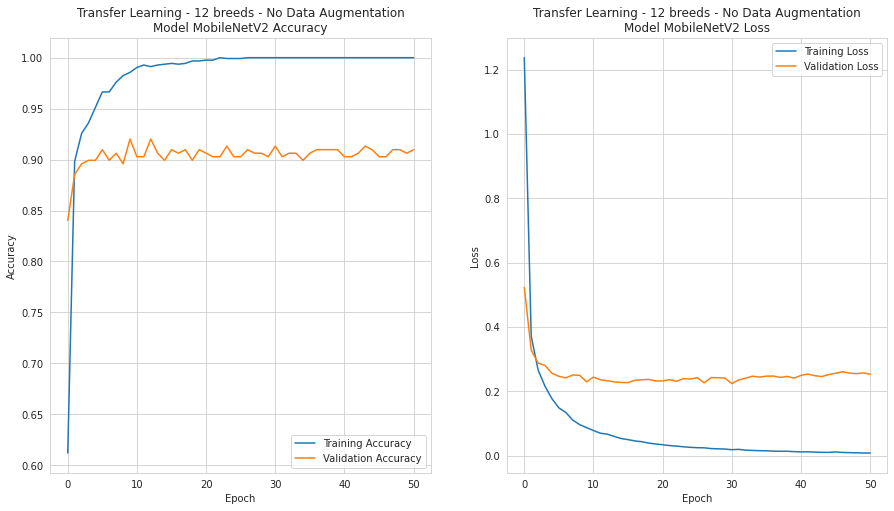

In [ ]:
plot_learning_curve(
    history,
    "Transfer Learning - 12 breeds - No Data Augmentation\nModel MobileNetV2"
    )

Le modèle overfitte sur le jeu de train sans data augmentation aux alentours de 25 epochs.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
# Model evaluation
model_MobileNetV2_eval = new_model_MobileNetV2_2.evaluate(test_iterator, 
                                          steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

12/12 [==============================] - 3s 267ms/step - loss: 0.3313 - accuracy: 0.9062
Loss on test set =  0.33127495646476746
Accuracy on test set =  0.90625


Nous obtenons une meilleure accuracy sans data augmentation sur le jeu de test. Par contre, le loss est un peu moins bon.

### **7.5. Transfer Learning avec Data Augmentation et couche `Flatten`** 
Dans cette partie, nous remplaçons la couche `GlobalAveragePooling2D` par une couche `Flatten` pour voir la différence en terme d'apprentissage.


#### **Ajout des dernières couches**

In [ ]:
nb_breeds = 12

# Get model output
x = imported_MobileNetV2.output

# Convert the feature vector into a 1280 element vector
x = Flatten()(x)
# last fully-connected layer to classify the 12 breeds
predictions = Dense(nb_breeds, activation='softmax')(x)

# Model Building
new_model_MobileNetV2_3 = Model(inputs = imported_MobileNetV2.input, 
                              outputs = predictions)

new_model_MobileNetV2_3.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                           

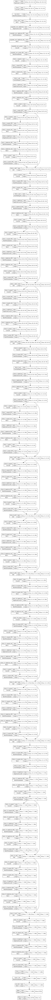

In [ ]:
# Save this architecture as an image 
tf.keras.utils.plot_model(new_model_MobileNetV2_3, 
                          breeds12_my_img_path + "/new_model_MobileNetV2_3.png", 
                          show_shapes=True)

#### **Compilation du modèle**

In [ ]:
# Model compilation
new_model_MobileNetV2_3.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**

In [ ]:
# File to save model
breeds12_model_file_path = breeds12_models_path + "/new_model_MobileNetV2_3.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 32

# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        fill_mode = "nearest",
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


#### **Entrainement du modèle**

In [ ]:
%%time

epochs = 100

history = new_model_MobileNetV2_3.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
40/40 [==============================] - ETA: 0s - loss: 5.3215 - accuracy: 0.5832
Epoch 1: val_accuracy improved from -inf to 0.88542, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/new_model_MobileNetV2_3.h5
40/40 [==============================] - 31s 651ms/step - loss: 5.3215 - accuracy: 0.5832 - val_loss: 1.3026 - val_accuracy: 0.8854
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 3.3279 - accuracy: 0.7544
Epoch 2: val_accuracy did not improve from 0.88542
40/40 [==============================] - 24s 610ms/step - loss: 3.3279 - accuracy: 0.7544 - val_loss: 1.1114 - val_accuracy: 0.8819
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 2.9405 - accuracy: 0.7800
Epoch 3: val_accuracy did not improve from 0.88542
40/40 [==============================] - 28s 687ms/step - loss: 2.9405 - accuracy: 0.7800 - val_loss: 1.8867 - val_accuracy: 0.8646
Epoch 4/100
40/40 [============================

In [ ]:
# Convert the history.history dict to a pandas DataFrame     
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_MobileNetV2_3.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

#### **Visualisation des résultats**

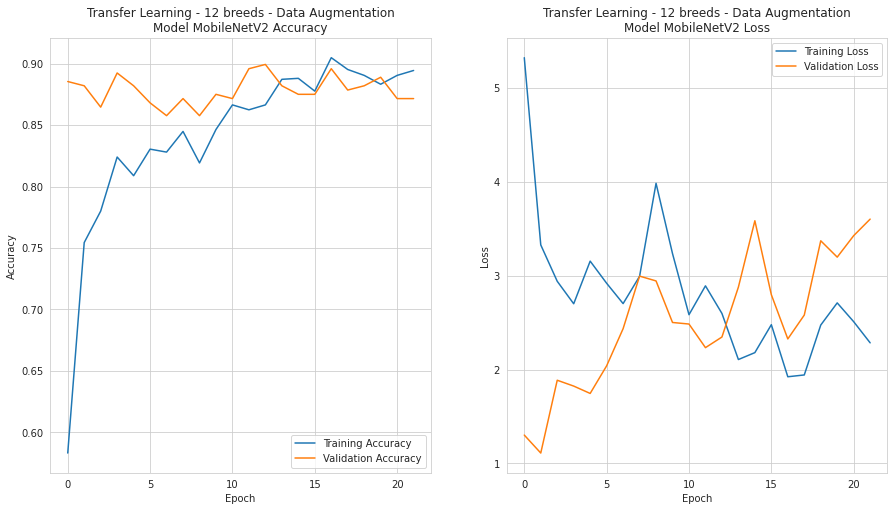

In [ ]:
plot_learning_curve(
    history, 
    "Transfer Learning - 12 breeds - Data Augmentation\nModel MobileNetV2"
    )

Le modèle semble avoir plus de mal à apprendre. Par ailleurs, l'apprentissage a été stoppé au bout de 22 epochs car le loss ne diminuait plus sur le jeu de validation.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
# Model evaluation
model_MobileNetV2_eval = new_model_MobileNetV2_3.evaluate(test_iterator, 
                                          steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

12/12 [==============================] - 2s 177ms/step - loss: 3.6342 - accuracy: 0.8438
Loss on test set =  3.6341588497161865
Accuracy on test set =  0.84375


L'accuracy est moins bonne que précédemment. Ceci peut s'expliquer par le fait que le modèle est entrainé sur moins d'epochs.

### **7.6. Transfer Learning SANS Data Augmentation et couche `Flatten`** 

#### **Construction du modèle**

In [ ]:
tf.keras.backend.clear_session()

from keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input

# Model importation without fully connected layers
imported_MobileNetV2 = MobileNetV2(weights="imagenet", 
                                   include_top=False, 
                                   input_shape=(224,224,3))

# We train only last layers
for layer in imported_MobileNetV2.layers:
    layer.trainable = False

nb_breeds = 12

# Get model output
x = imported_MobileNetV2.output

# Convert the feature vector into a 1280 element vector
x = Flatten()(x)
# last fully-connected layer to classify the 12 breeds
predictions = Dense(nb_breeds, activation='softmax')(x)

# Model Building
new_model_MobileNetV2_4 = Model(inputs = imported_MobileNetV2.input, 
                              outputs = predictions)

new_model_MobileNetV2_4.summary()

9420800/9406464 [==============================] - 0s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                               

#### **Compilation du modèle**

In [ ]:
# Model compilation
new_model_MobileNetV2_4.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

#### **Callbacks**

In [ ]:
# Create repository to save models
breeds12_models_path = os.path.join(breeds12_data_rep, "models")
os.makedirs(breeds12_models_path, exist_ok=True)

In [ ]:
# File to save model
breeds12_model_file_path = breeds12_models_path + "/new_model_MobileNetV2_4.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='min')

#### **Pré-traitements des images**

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 32

# ImageDataGenerator
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


#### **Entrainement du modèle**

In [ ]:
%%time

# NO GPU
breeds12_train_size = 1282
breeds12_validation_size = 293

epochs = 100

history = new_model_MobileNetV2_4.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
40/40 [==============================] - ETA: 0s - loss: 2.5955 - accuracy: 0.7584 
Epoch 1: val_accuracy improved from -inf to 0.86806, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/new_model_MobileNetV2_4.h5
40/40 [==============================] - 526s 13s/step - loss: 2.5955 - accuracy: 0.7584 - val_loss: 1.4518 - val_accuracy: 0.8681
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 0.5567 - accuracy: 0.9336
Epoch 2: val_accuracy improved from 0.86806 to 0.87500, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/new_model_MobileNetV2_4.h5
40/40 [==============================] - 57s 1s/step - loss: 0.5567 - accuracy: 0.9336 - val_loss: 1.7443 - val_accuracy: 0.8750
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 0.2494 - accuracy: 0.9648
Epoch 3: val_accuracy improved from 0.87500 to 0.88194, saving model to /content/drive/My Drive/Formation/Dog C

In [ ]:
# Convert the history.history dict to a pandas DataFrame   
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_MobileNetV2_4.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

#### **Visualisation des résultats**

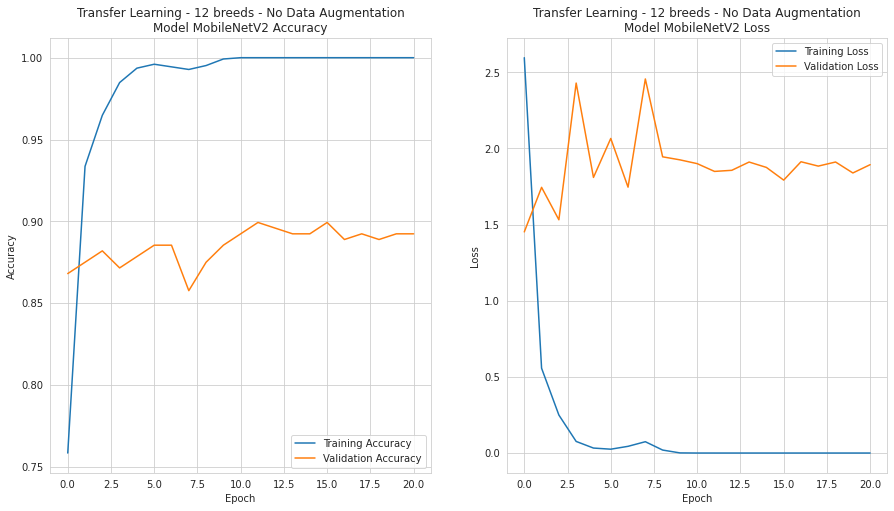

In [ ]:
plot_learning_curve(
    history,
    "Transfer Learning - 12 breeds - No Data Augmentation\nModel MobileNetV2"
    )

Le modèle overfitte sur le jeu de train sans data augmentation aux alentours de 10 epochs. L'accuracy du jeu de validation reste inférieure à 0.9. Par ailleurs, le loss sur le jeu de validation est compris entre 1.5 et 2.5.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
breeds12_test_size = 389

# Model evaluation
model_MobileNetV2_eval = new_model_MobileNetV2_4.evaluate(test_iterator, 
                                          steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

12/12 [==============================] - 130s 12s/step - loss: 2.6018 - accuracy: 0.8594
Loss on test set =  2.601832866668701
Accuracy on test set =  0.859375


Ici aussi l'accuracy est moins bonne qu'avec la couche de `GlobalAveragePooling2D`.

### **7.7. Comparaison des modèles**
Nous visualisons sur un graphe l'accuracy des jeux d'entrainement et de validation des différents modèles que nous avons testés.

In [ ]:
images_dir_path = '/content/drive/My Drive/Formation/Dog Classification'
breeds12_data_rep = os.path.join(images_dir_path,'breeds12_data')
breeds12_models_path = os.path.join(breeds12_data_rep, "models")

# Load history 
# From Scratch / GlobalAveragePooling / No Data Augmentation / Batch size 32
hist_csv_file_myGAP_NODA = breeds12_models_path + "/history_my_MobileNetV2.csv"
hist_df_myGAP_NODA = pd.read_csv(hist_csv_file_myGAP_NODA)

# From Scratch / GlobalAveragePooling / Data Augmentation / Batch size 32
hist_csv_file_myGAP_DA = breeds12_models_path + "/history_my_MobileNetV2_2.csv"
hist_df_myGAP_DA = pd.read_csv(hist_csv_file_myGAP_DA)

# GlobalAveragePooling / Data Augmentation / Batch size 32
hist_csv_file_GAP_DA = breeds12_models_path + "/history_MobileNetV2.csv"
hist_df_GAP_DA = pd.read_csv(hist_csv_file_GAP_DA)

# GlobalAveragePooling / No Data Augmentation / Batch size 32
hist_csv_file_GAP_NODA = breeds12_models_path + "/history_MobileNetV2_2.csv"
hist_df_GAP_NODA = pd.read_csv(hist_csv_file_GAP_NODA)

# Flatten / Data Augmentation / Batch size 32
hist_csv_file_F_DA = breeds12_models_path + "/history_MobileNetV2_3.csv"
hist_df_F_DA = pd.read_csv(hist_csv_file_F_DA)

# Flatten / No Data Augmentation / Batch size 32
hist_csv_file_F_NODA = breeds12_models_path + "/history_MobileNetV2_4.csv"
hist_df_F_NODA = pd.read_csv(hist_csv_file_F_NODA)

In [ ]:
def plot_results(metrics, ymin, ymax) :
  plt.figure(figsize=(13,10))
  accur = ['accuracy','val_accuracy']

  if metrics in accur :
    plt.plot(hist_df_GAP_DA[metrics],
             label='GlobalAv/Data Aug/32 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_GAP_DA[metrics])))
    plt.plot(hist_df_GAP_NODA[metrics],
             label='GlobalAv/NO Data Aug/32 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_GAP_NODA[metrics])))
    plt.plot(hist_df_F_DA[metrics],
             label='Flatten/Data Aug/32 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_F_DA[metrics])))
    plt.plot(hist_df_F_NODA[metrics],
             label='Flatten/NO Data Aug/32 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_F_NODA[metrics])))
    plt.plot(hist_df_myGAP_NODA[metrics],
             label='myGlobalAv/No Data Aug/32 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_myGAP_NODA[metrics])))
    plt.plot(hist_df_myGAP_DA[metrics],
             label='myGlobalAv/Data Aug/32 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_myGAP_DA[metrics])))
  else :
    plt.plot(hist_df_GAP_DA[metrics],
             label='GlobalAv/Data Aug/32 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_GAP_DA[metrics])))
    plt.plot(hist_df_GAP_NODA[metrics],
             label='GlobalAv/NO Data Aug/32 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_GAP_NODA[metrics])))
    plt.plot(hist_df_F_DA[metrics],
             label='Flatten/Data Aug/32 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_F_DA[metrics])))
    plt.plot(hist_df_F_NODA[metrics],
             label='Flatten/NO Data Aug/32 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_F_NODA[metrics])))
    plt.plot(hist_df_myGAP_NODA[metrics],
             label='myGlobalAv/No Data Aug/32 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_myGAP_NODA[metrics])))
    plt.plot(hist_df_myGAP_DA[metrics],
             label='myGlobalAv/Data Aug/32 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_myGAP_DA[metrics])))
    
  plt.title('{} of different MobileNetV2 models over epochs'.format(metrics),
              fontsize=18)
  plt.ylabel(metrics)
  plt.xlabel('epoch')
  plt.ylim(ymin+0.01, ymax+0.01)
  plt.legend()
  plt.show()

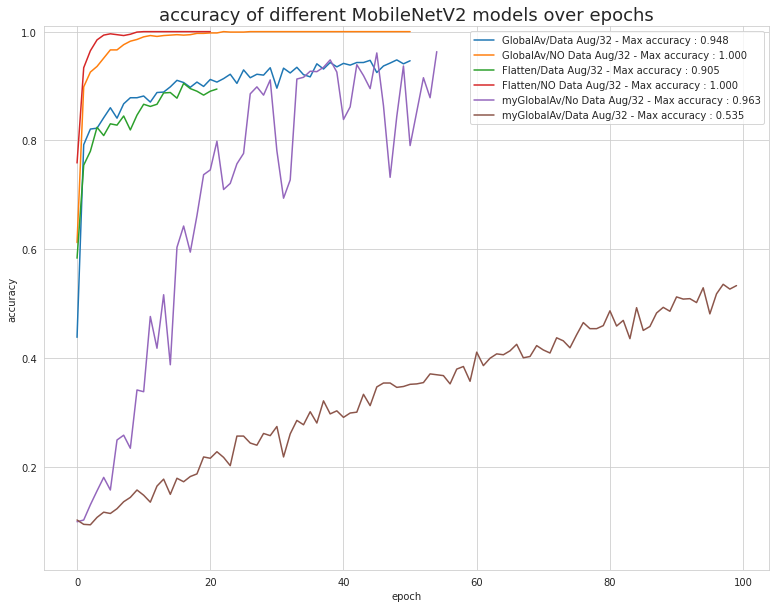

In [ ]:
# Accuracy on train set with models from scratch
plot_results('accuracy', ymin = 0, ymax = 1)

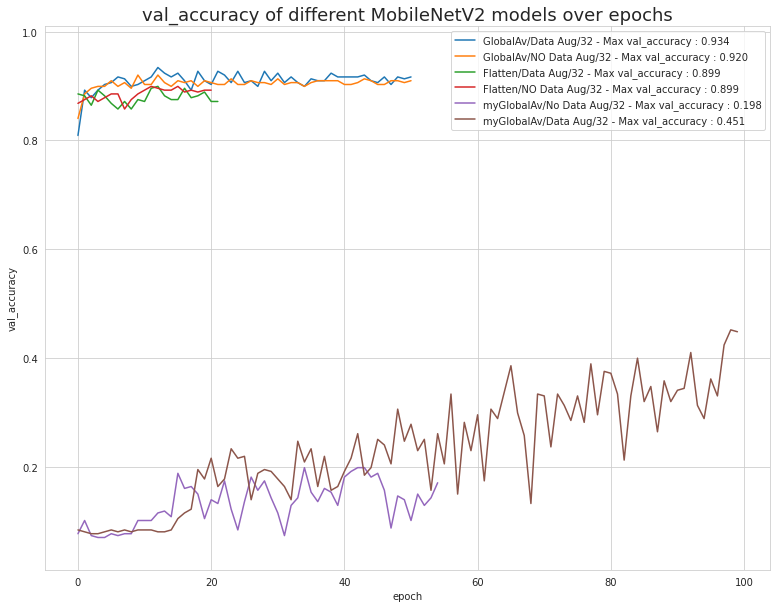

In [ ]:
# Accuracy on validation set with models from scratch
plot_results('val_accuracy', ymin = 0, ymax = 1)

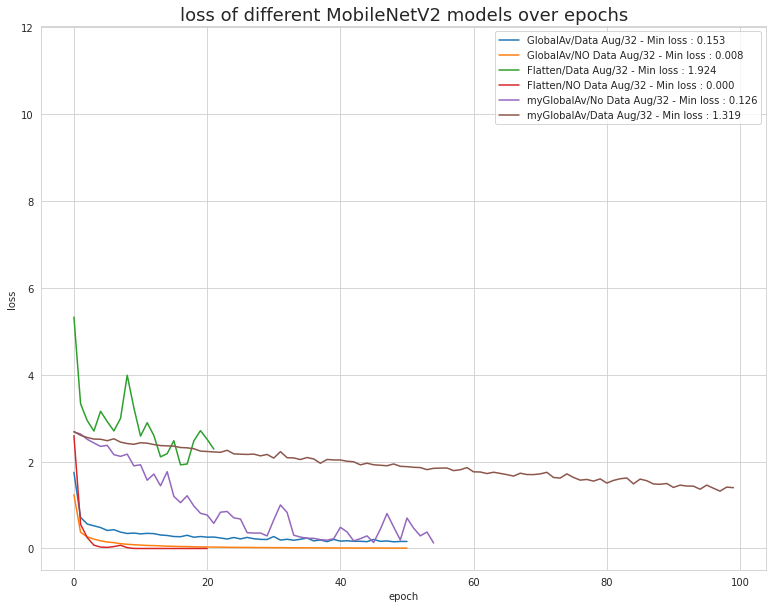

In [ ]:
# Loss on training set with models from scratch
plot_results('loss', ymin = -0.5, ymax = 12)

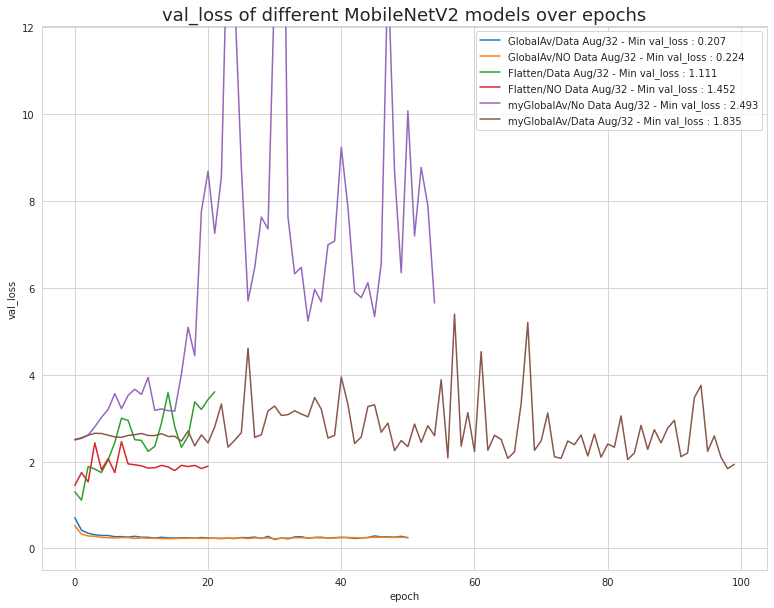

In [ ]:
# Loss on validation set with models from scratch
plot_results('val_loss', ymin = -0.5, ymax = 12)

### **7.8. Influence du batch size** 
Dans cette partie, nous regardons l'influence du batch_size lors de la phase d'apprentissage. Nous gardons la même architecture que dans la partie 7.3, toujours avec une Data Augmentation.



#### **Importation du modèle**

In [ ]:
tf.keras.backend.clear_session()

from keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input

# Model importation without fully connected layers
imported_MobileNetV2 = MobileNetV2(weights="imagenet", 
                                   include_top=False, 
                                   input_shape=(224,224,3))

# We train only last layers
for layer in imported_MobileNetV2.layers:
    layer.trainable = False

9420800/9406464 [==============================] - 0s 0us/step


#### **Ajout des dernières couches**

In [ ]:
nb_breeds = 12

def create_model(nb_breeds) :
  """
    Function to create model from imported MobileNetV2 with last layers
    modified with GlobalAveragePooling2D and Dense

    Arguments :
    - nb_breeds : number of breeds to consider (= number of classes)

    Return :
    - model of MobileNetV2 with last layers modified
  """

  # Get model output
  x = imported_MobileNetV2.output

  # Convert the feature vector into a 1280 element vector
  x = GlobalAveragePooling2D()(x)
  # last fully-connected layer to classify the 12 breeds
  predictions = Dense(nb_breeds, activation='softmax')(x)

  # Model Building
  return Model(inputs = imported_MobileNetV2.input, 
                              outputs = predictions)

#### **Batch_size = 16**

In [ ]:
model_MobileNetV2_16b = create_model(nb_breeds)

##### ***Compilation du modèle***

In [ ]:
# Model compilation
model_MobileNetV2_16b.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

##### ***Callbacks***

In [ ]:
# File to save model
breeds12_model_file_path = breeds12_models_path + "/model_MobileNetV2_16b.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='min')

##### ***Pré-traitements des images***

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 16

# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        fill_mode = "nearest",
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


##### ***Entrainement du modèle***

In [ ]:
%%time
breeds12_train_size = 1282
breeds12_validation_size = 293

epochs = 100

history = model_MobileNetV2_16b.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
80/80 [==============================] - ETA: 0s - loss: 1.3124 - accuracy: 0.5861
Epoch 1: val_accuracy improved from -inf to 0.88542, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/model_MobileNetV2_16b.h5
80/80 [==============================] - 31s 336ms/step - loss: 1.3124 - accuracy: 0.5861 - val_loss: 0.4563 - val_accuracy: 0.8854
Epoch 2/100
80/80 [==============================] - ETA: 0s - loss: 0.6340 - accuracy: 0.7962
Epoch 2: val_accuracy improved from 0.88542 to 0.90278, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/model_MobileNetV2_16b.h5
80/80 [==============================] - 26s 331ms/step - loss: 0.6340 - accuracy: 0.7962 - val_loss: 0.3240 - val_accuracy: 0.9028
Epoch 3/100
80/80 [==============================] - ETA: 0s - loss: 0.5379 - accuracy: 0.8088
Epoch 3: val_accuracy did not improve from 0.90278
80/80 [==============================] - 26s 321ms/step - los

In [ ]:
# Convert the history.history dict to a pandas DataFrame  
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_MobileNetV2_16b.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)


##### ***Visualisation des résultats***

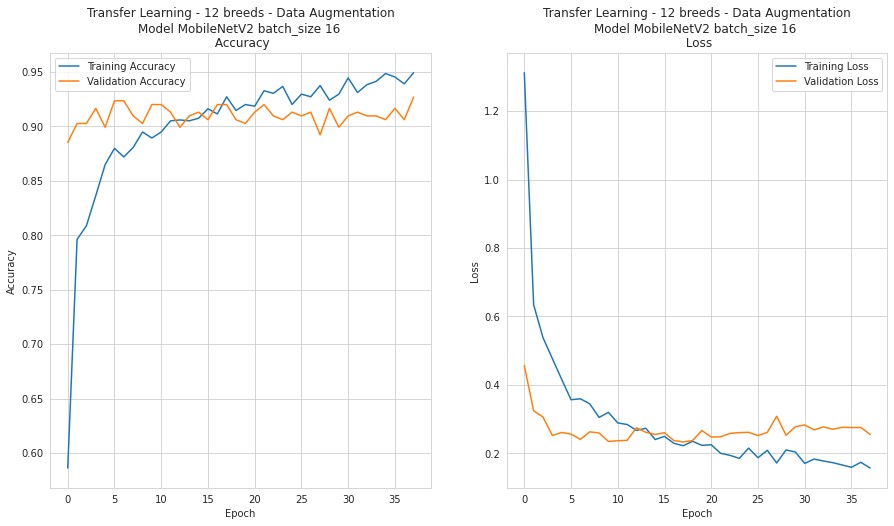

In [ ]:
plot_learning_curve(
    history, 
    "Transfer Learning - 12 breeds - Data Augmentation\nModel MobileNetV2 batch_size 16 \n"
    )

##### ***Evaluation du modèle***
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
breeds12_test_size = 389

# Model evaluation
model_MobileNetV2_eval = model_MobileNetV2_16b.evaluate(test_iterator, 
                                          steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

24/24 [==============================] - 2s 96ms/step - loss: 0.3436 - accuracy: 0.8880
Loss on test set =  0.3436093032360077
Accuracy on test set =  0.8880208134651184


#### **Batch_size = 64**

In [ ]:
tf.keras.backend.clear_session()

model_MobileNetV2_64b = create_model(nb_breeds)

##### ***Compilation du modèle***

In [ ]:
# Model compilation
model_MobileNetV2_64b.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),  
              metrics=["accuracy"])

##### ***Callbacks***

In [ ]:
# File to save model
breeds12_model_file_path = breeds12_models_path + "/model_MobileNetV2_64b.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='min')

##### ***Pré-traitements des images***

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 64

# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        fill_mode = "nearest",
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


##### ***Entrainement du modèle***

In [ ]:
%%time

breeds12_train_size = 1282
breeds12_validation_size = 293

epochs = 100

history = model_MobileNetV2_64b.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
20/20 [==============================] - ETA: 0s - loss: 1.9915 - accuracy: 0.3629
Epoch 1: val_accuracy improved from -inf to 0.72656, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/model_MobileNetV2_64b.h5
20/20 [==============================] - 29s 1s/step - loss: 1.9915 - accuracy: 0.3629 - val_loss: 0.9923 - val_accuracy: 0.7266
Epoch 2/100
20/20 [==============================] - ETA: 0s - loss: 0.9310 - accuracy: 0.7225
Epoch 2: val_accuracy improved from 0.72656 to 0.86328, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/model_MobileNetV2_64b.h5
20/20 [==============================] - 26s 1s/step - loss: 0.9310 - accuracy: 0.7225 - val_loss: 0.5523 - val_accuracy: 0.8633
Epoch 3/100
20/20 [==============================] - ETA: 0s - loss: 0.7047 - accuracy: 0.7685
Epoch 3: val_accuracy improved from 0.86328 to 0.87891, saving model to /content/drive/My Drive/Formation/Dog Classifi

In [ ]:
# Convert the history.history dict to a pandas DataFrame   
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_MobileNetV2_64b.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

##### ***Visualisation des résultats***

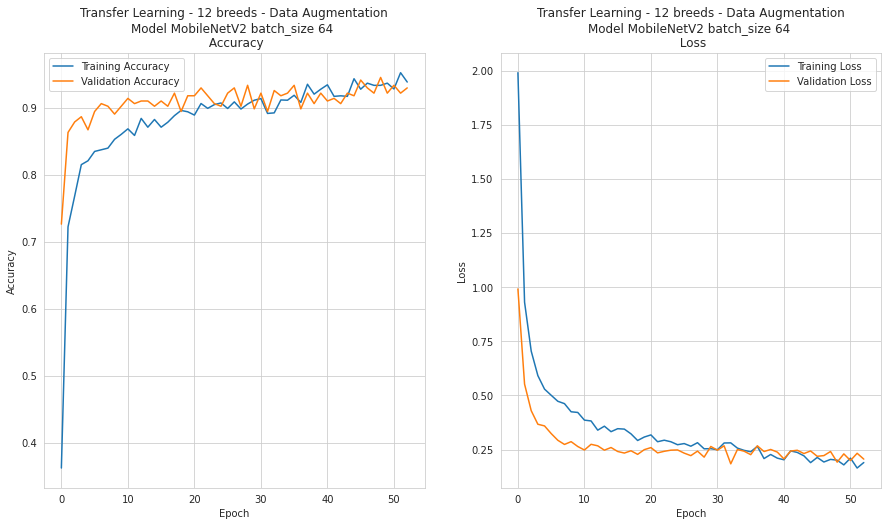

In [ ]:
plot_learning_curve(
    history, 
    "Transfer Learning - 12 breeds - Data Augmentation\nModel MobileNetV2 batch_size 64 \n"
    )

##### ***Evaluation du modèle***
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
breeds12_test_size = 389

# Model evaluation
model_MobileNetV2_eval = model_MobileNetV2_64b.evaluate(test_iterator, 
                                          steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

6/6 [==============================] - 2s 344ms/step - loss: 0.3043 - accuracy: 0.8854
Loss on test set =  0.3043389320373535
Accuracy on test set =  0.8854166865348816


#### **Comparaison des modèles selon la taille du batch**
Nous visualisons sur des graphes l'accuracy et le loss des jeux d'entrainement et de validation selon différentes tailles de batch.

In [ ]:
breeds12_models_path = os.path.join(breeds12_data_rep, "models")

# Load history 

# GlobalAveragePooling / Data Augmentation / Batch size 32
hist_csv_file_GAP_DA = breeds12_models_path + "/history_MobileNetV2.csv"
hist_df_GAP_DA = pd.read_csv(hist_csv_file_GAP_DA)

# GlobalAveragePooling / Data Augmentation / Batch size 16
hist_csv_file_16b = breeds12_models_path + "/history_MobileNetV2_16b.csv"
hist_df_16b = pd.read_csv(hist_csv_file_16b)

# GlobalAveragePooling / Data Augmentation / Batch size 64
hist_csv_file_64b = breeds12_models_path + "/history_MobileNetV2_64b.csv"
hist_df_64b = pd.read_csv(hist_csv_file_64b)

In [ ]:
def plot_results_bis(metrics, ymin, ymax) :
  plt.figure(figsize=(13,10))
  accur = ['accuracy','val_accuracy']
  
  if metrics in accur :
    plt.plot(hist_df_GAP_DA[metrics],
             label='GlobalAv/Data Aug/32 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_GAP_DA[metrics])))
    plt.plot(hist_df_16b[metrics],
             label='GlobalAv/Data Aug/16 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_16b[metrics])))
    plt.plot(hist_df_64b[metrics],
             label='GlobalAv/Data Aug/64 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_64b[metrics])))
  else :
    plt.plot(hist_df_GAP_DA[metrics],
             label='GlobalAv/Data Aug/32 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_GAP_DA[metrics])))
    plt.plot(hist_df_16b[metrics],
             label='GlobalAv/Data Aug/16 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_16b[metrics])))
    plt.plot(hist_df_64b[metrics],
             label='GlobalAv/Data Aug/64 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_64b[metrics])))
    
  plt.title('Influence of batch size on {} of MobileNetV2 models'.format(metrics),
              fontsize=18)
  plt.ylabel(metrics)
  plt.xlabel('epoch')
  plt.ylim(ymin+0.01, ymax+0.01)
  plt.legend()
  plt.show()

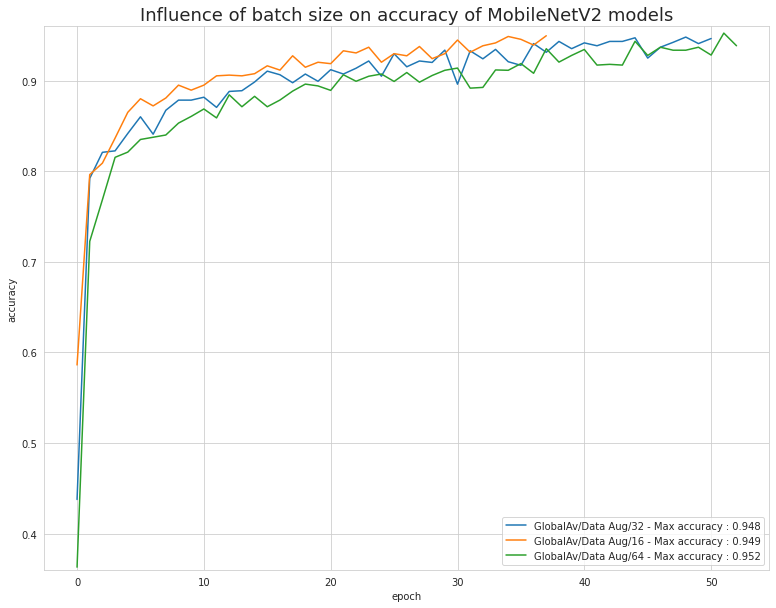

In [ ]:
# Accuracy on train set 
plot_results_bis('accuracy', ymin = 0.35, ymax = 0.95)

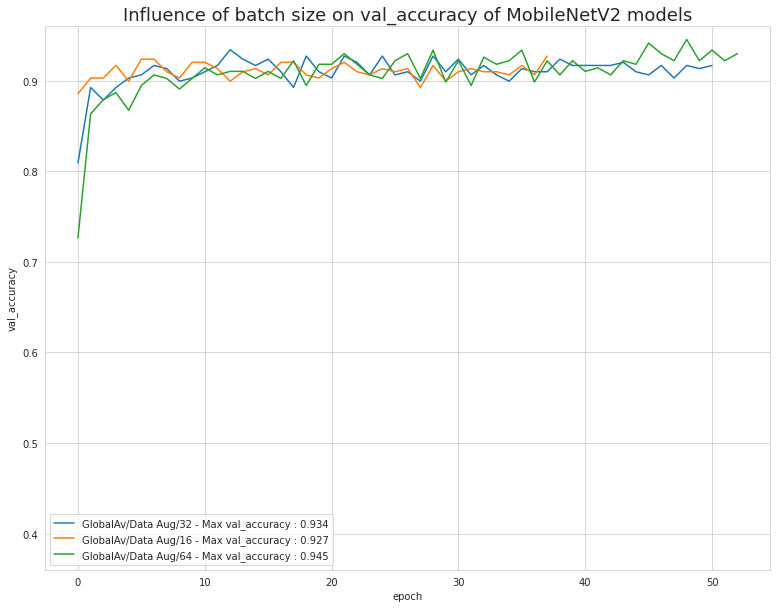

In [ ]:
# Accuracy on validation set 
plot_results_bis('val_accuracy', ymin = 0.35, ymax = 0.95)

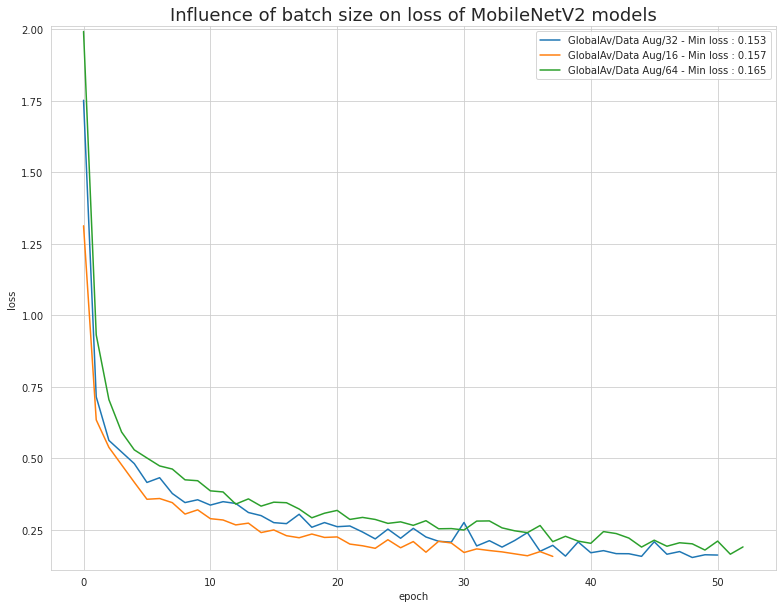

In [ ]:
# Loss on train set 
plot_results_bis('loss', ymin = 0.1, ymax = 2)

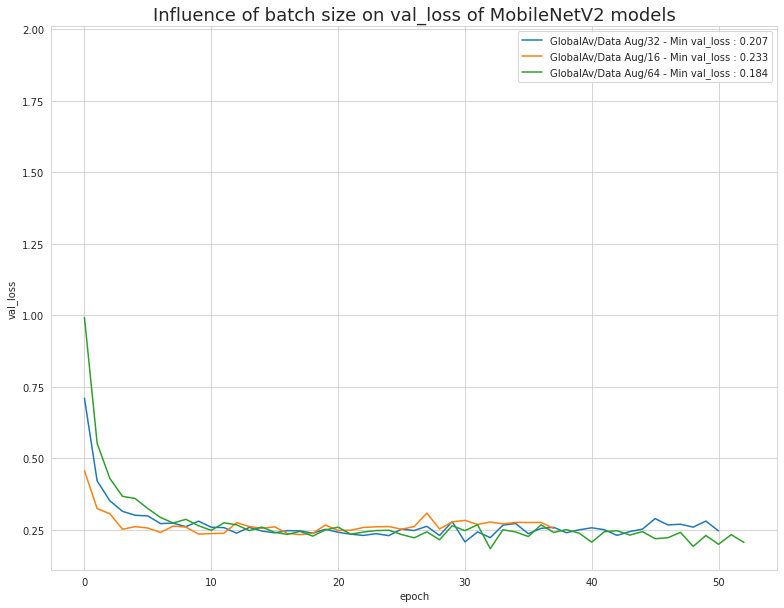

In [ ]:
# Loss on validation set 
plot_results_bis('val_loss', ymin = 0.1, ymax = 2)

D'après les courbes, nous voyons que sur le jeu de validation, un batch de 64 présente les meilleurs résultats avec une accuracy maximale de 0.945 et un loss minimal de 0.184.

### **7.9. Recherche du meilleur learning rate pour le modèle batch 64**
Nous allons utiliser `kerastuner` pour optimiser le learning rate du classifieur.

Nous partons sur un modèle avec une couche de `GlobalAveragePooling2D`.

In [ ]:
!pip install -q -U keras-tuner

     |████████████████████████████████| 98 kB 3.4 MB/s 


In [ ]:
import keras_tuner as kt

#### **Définition du modèle**

In [ ]:
tf.keras.backend.clear_session()

from keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input

nb_breeds = 12

def build_opt_model(hp):

  # Model importation without fully connected layers
  imported_MobileNetV2 = MobileNetV2(weights="imagenet", 
                                   include_top=False, 
                                   input_shape=(224,224,3))

  # We train only last layers
  for layer in imported_MobileNetV2.layers:
    layer.trainable = False
  
  # Get model output
  x = imported_MobileNetV2.output

  # Convert the feature vector into a 1280 element vector
  x = GlobalAveragePooling2D()(x)

  # last fully-connected layer to classify the 12 breeds
  predictions = Dense(nb_breeds, activation='softmax')(x)

  # Model Building
  model_MobileNetV2 = Model(inputs = imported_MobileNetV2.input, 
                              outputs = predictions)
  
  # Tune learning rate
  hp_learning_rate = hp.Choice(name='learning_rate',
        values=[1e-1, 1e-2, 1e-3, 1e-4])

  # Model compilation
  model_MobileNetV2.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(hp_learning_rate),  
              metrics=["accuracy"])
    
  return model_MobileNetV2

#### **Instantiation du modèle**

In [ ]:
# Construct the tuner of kerastuner
tuner = kt.RandomSearch(
    build_opt_model, 
    objective='val_accuracy',
    max_trials=5)

##### ***Callbacks***

In [ ]:
# Early stop
early_stop = EarlyStopping(monitor='val_accuracy', 
                      min_delta=0, 
                      patience=5, 
                      verbose=1, 
                      mode='max')

##### ***Pré-traitements des images***

In [ ]:
# Image size
SIZE = 224

# Batch size
BATCH_SIZE = 64

# ImageDataGenerator
datagen_train = ImageDataGenerator(rotation_range=45, 
        width_shift_range=0.2, 
        height_shift_range=0.2, 
        zoom_range=0.25, 
        horizontal_flip=True, 
        brightness_range=[0.5,1.5],
        fill_mode = "nearest",
        preprocessing_function=preprocess_input)

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
                                   
# Create iterator for trainset
train_iterator = datagen_train.flow_from_directory(breeds12_train_path,
                                              target_size=(SIZE,SIZE),
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical",
                                              shuffle = True,
                                              seed = 42)

# Create iterator for validationset
validation_iterator = datagen.flow_from_directory(breeds12_validation_path,
                                          target_size=(SIZE,SIZE),
                                          batch_size=BATCH_SIZE,
                                          class_mode='categorical',
                                          shuffle = True,
                                          seed = 42)

Found 1282 images belonging to 12 classes.
Found 293 images belonging to 12 classes.


#### **Tuning du modèle**

In [ ]:
# Search best params
tuner.search(train_iterator,
             validation_data=validation_iterator,
             epochs=30,
             callbacks=[early_stop])

# Get the optimal hyperparameter
best_hyperparam = tuner.get_best_hyperparameters(num_trials=1)[0]

print("-" * 50)
print("MobileNetV2 Learning Rate optimization :")
print("Best learning rate : ", best_hyperparam.get('learning_rate'))

Trial 4 Complete [00h 14m 32s]
val_accuracy: 0.8668941855430603

Best val_accuracy So Far: 0.9283276200294495
Total elapsed time: 00h 35m 52s
INFO:tensorflow:Oracle triggered exit
--------------------------------------------------
MobileNetV2 Learning Rate optimization :
Best learning rate :  0.001


#### **Entrainement du meilleur modèle**

In [ ]:
# Build the model with the optimal hyperparameters
opt_model_MobileNetV2 = tuner.hypermodel.build(best_hyperparam)

# File to save model
breeds12_models_path = os.path.join(breeds12_data_rep, "models")
breeds12_model_file_path = breeds12_models_path + "/opt_model_MobileNetV2_ter.h5"

# Checkpoint
checkpoint = ModelCheckpoint(filepath = breeds12_model_file_path, 
                             monitor='val_accuracy', 
                             verbose=1, 
                             save_best_only=True, 
                             save_weights_only=False, 
                             mode='max')

# Early stop
early_stop = EarlyStopping(monitor='val_loss', 
                      min_delta=0, 
                      patience=20, 
                      verbose=1, 
                      mode='min')

In [ ]:
%%time

breeds12_train_size = 1282
breeds12_validation_size = 293

epochs = 100

history = opt_model_MobileNetV2.fit(
                train_iterator,
                steps_per_epoch = breeds12_train_size // BATCH_SIZE, 
                epochs=epochs,
                validation_data=validation_iterator,
                validation_steps = breeds12_validation_size // BATCH_SIZE,
                callbacks=[checkpoint, early_stop])

Epoch 1/100
20/20 [==============================] - ETA: 0s - loss: 1.9322 - accuracy: 0.3662
Epoch 1: val_accuracy improved from -inf to 0.73047, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/opt_model_MobileNetV2_ter.h5
20/20 [==============================] - 33s 1s/step - loss: 1.9322 - accuracy: 0.3662 - val_loss: 1.0556 - val_accuracy: 0.7305
Epoch 2/100
20/20 [==============================] - ETA: 0s - loss: 0.9841 - accuracy: 0.7094
Epoch 2: val_accuracy improved from 0.73047 to 0.85156, saving model to /content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/opt_model_MobileNetV2_ter.h5
20/20 [==============================] - 31s 2s/step - loss: 0.9841 - accuracy: 0.7094 - val_loss: 0.5678 - val_accuracy: 0.8516
Epoch 3/100
20/20 [==============================] - ETA: 0s - loss: 0.6940 - accuracy: 0.7930
Epoch 3: val_accuracy improved from 0.85156 to 0.91016, saving model to /content/drive/My Drive/Formation/Dog 

In [ ]:
# Convert the history.history dict to a pandas DataFrame
hist_df = pd.DataFrame(history.history) 

# Save to csv
hist_csv_file = breeds12_models_path + "/history_opt_MobileNetV2_ter.csv"
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

#### **Visualisation des résultats**

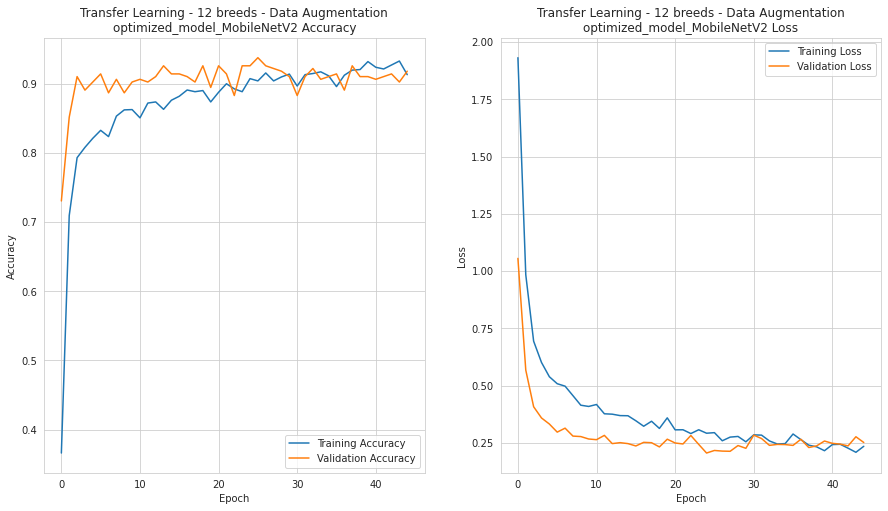

In [ ]:
plot_learning_curve(
    history, 
    "Transfer Learning - 12 breeds - Data Augmentation\noptimized_model_MobileNetV2"
    )

Les courbes d'apprentissage sont quasiment identiques à celles de la partie 7.8.

#### **Evaluation du modèle**
Nous évaluons le modèle sur le jeu de test.

In [ ]:
# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
breeds12_test_size = 389

# Model evaluation
model_MobileNetV2_eval = opt_model_MobileNetV2.evaluate(test_iterator, 
                                          steps=breeds12_test_size // BATCH_SIZE)
print("Loss on test set = ", model_MobileNetV2_eval[0])
print("Accuracy on test set = ",model_MobileNetV2_eval[1])

6/6 [==============================] - 73s 15s/step - loss: 0.2908 - accuracy: 0.8932
Loss on test set =  0.29078882932662964
Accuracy on test set =  0.8932291865348816


Nous obtenons des résultats meilleurs que le modèle batch size 64 précédent.

### **7.10. Comparaison des modèles après optimisation**
Nous visualisons sur un graphe l'accuracy et le loss des jeux d'entrainement et de validation des 2 modèles avec learning rate de 0.001 et batch size de 64.

In [ ]:
breeds12_models_path = os.path.join(breeds12_data_rep, "models")

# Load history 

# GlobalAveragePooling / Data Augmentation / Batch size 64
hist_csv_file_64b = breeds12_models_path + "/history_MobileNetV2_64b.csv"
hist_df_64b = pd.read_csv(hist_csv_file_64b)

# GlobalAveragePooling / Data Augmentation / Batch size 64 / Optimized
hist_csv_file_GAP_DA_opt_64 = breeds12_models_path + "/history_opt_MobileNetV2_ter.csv"
hist_df_GAP_DA_opt_64 = pd.read_csv(hist_csv_file_GAP_DA_opt_64)

In [ ]:
def plot_results_ter(metrics, ymin, ymax) :
  plt.figure(figsize=(13,10))
  accur = ['accuracy','val_accuracy']
  
  if metrics in accur :
    plt.plot(hist_df_64b[metrics],
             label='GlobalAv/Data Aug/64 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_64b[metrics])))
    plt.plot(hist_df_GAP_DA_opt_64[metrics],
             label='Opt/GlobalAv/Data Aug/64 - Max {} : {:.3f}'.format(metrics,
                 np.max(hist_df_GAP_DA_opt_64[metrics])))
  else :
    plt.plot(hist_df_64b[metrics],
             label='GlobalAv/Data Aug/64 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_64b[metrics])))
    plt.plot(hist_df_GAP_DA_opt_64[metrics],
             label='Opt/GlobalAv/Data Aug/64 - Min {} : {:.3f}'.format(metrics,
                 np.min(hist_df_GAP_DA_opt_64[metrics])))
  
  plt.title('{} of optimized vs unoptimized MobileNetV2 models\n Batche size 64'.format(metrics),
              fontsize=18)
  plt.ylabel(metrics)
  plt.xlabel('epoch')
  plt.ylim(ymin+0.01, ymax+0.01)
  plt.legend()
  plt.show()

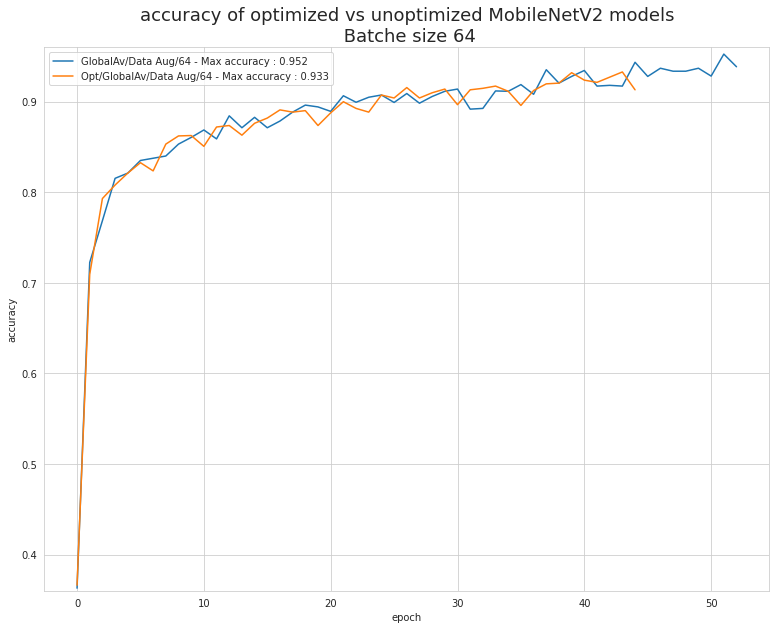

In [ ]:
# Accuracy on train set 
plot_results_ter('accuracy', ymin = 0.35, ymax = 0.95)

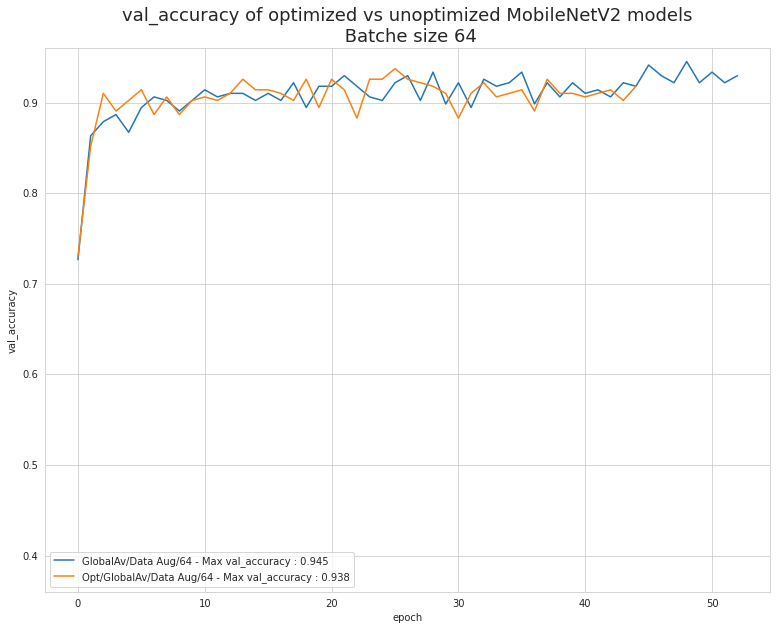

In [ ]:
# Accuracy on validation set 
plot_results_ter('val_accuracy', ymin = 0.35, ymax = 0.95)

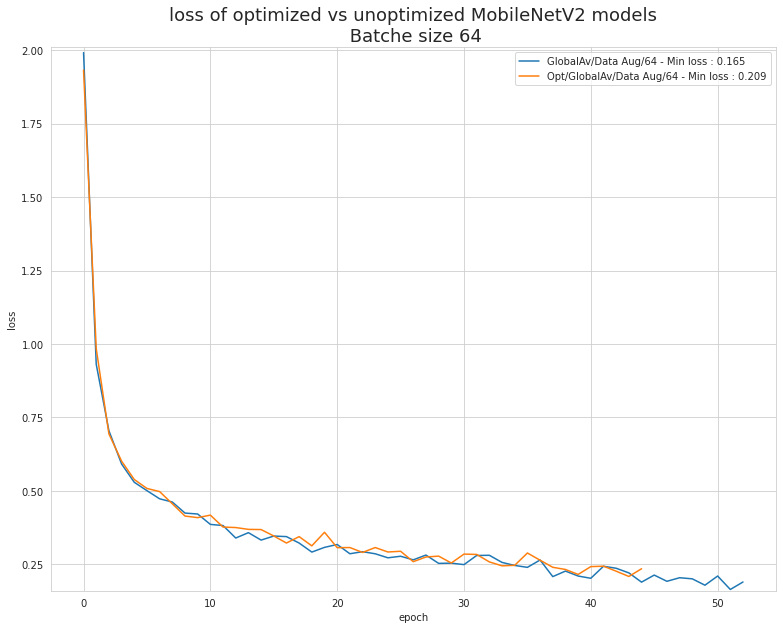

In [ ]:
# Loss on training set 
plot_results_ter('loss', ymin = 0.15, ymax = 2)

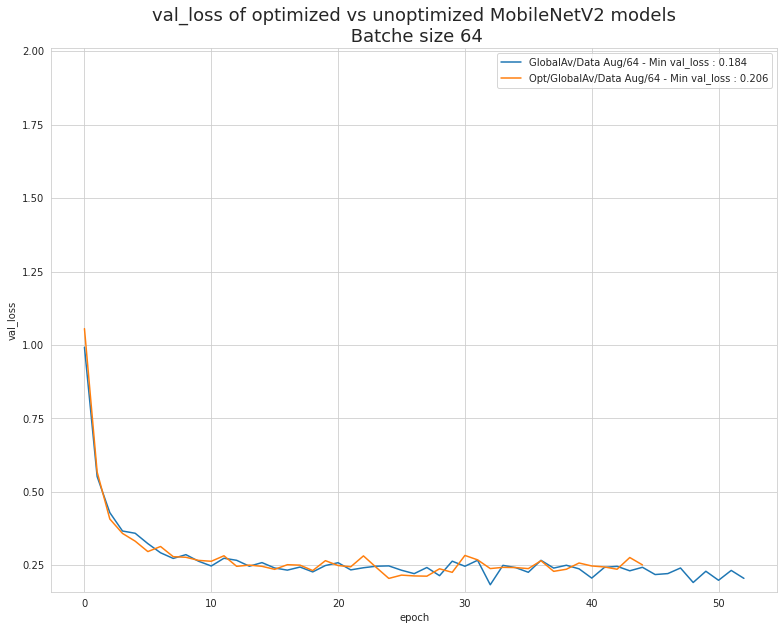

In [ ]:
# Loss on validation set 
plot_results_ter('val_loss', ymin = 0.15, ymax = 2)

Les valeurs d'accuracy et de loss sont meilleures sur le modèle entrainé suite à la recherche du meilleur learning rate.

## **8. Prédictions**

### **8.1. Récupération des labels "races prédites"**
Nous retenons comme modèle celui obtenu à l'issu de la recherche du meilleur learning rate car il présente les meilleures valeurs de métriques.

In [ ]:
# Load final model
breeds12_models_path = os.path.join(breeds12_data_rep, "models")
breeds12_model_file_path = breeds12_models_path + "/opt_model_MobileNetV2_ter.h5"

final_model = keras.models.load_model(breeds12_model_file_path)

In [ ]:
from keras.applications.mobilenet_v2 import preprocess_input

SIZE = 224
BATCH_SIZE = 64

datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Create iterator for testset
test_iterator = datagen.flow_from_directory(breeds12_test_path,
                                            target_size=(SIZE,SIZE),
                                            batch_size=BATCH_SIZE,
                                            class_mode='categorical',
                                            shuffle = False,
                                            seed = 42)

Found 389 images belonging to 12 classes.


In [ ]:
# Get predictions
pred_all = final_model.predict(test_iterator)

In [ ]:
# Get predicted breeds array
pred_breeds = np.argmax(pred_all, axis=1)

# Get actual breeds array
actual_breeds = test_iterator.labels

In [ ]:
# Get list of breed from test_iterator.class_indices dictionnary 
list_breeds_it = [k.split("-")[-1] for k in test_iterator.class_indices.keys()]
list_breeds_it

['beagle',
 'Staffordshire_bullterrier',
 'American_Staffordshire_terrier',
 'Australian_terrier',
 'golden_retriever',
 'Labrador_retriever',
 'English_setter',
 'Brittany_spaniel',
 'cocker_spaniel',
 'malinois',
 'German_shepherd',
 'French_bulldog']

In [ ]:
# Save this list for the model
filename = breeds12_models_path + '/list_breeds.joblib'
joblib.dump(list_breeds_it, filename)

['/content/drive/My Drive/Formation/Dog Classification/breeds12_data/models/list_breeds.joblib']

Nous affichons aléatoirement 12 images de chien avec leur véritable race et la race prédite.

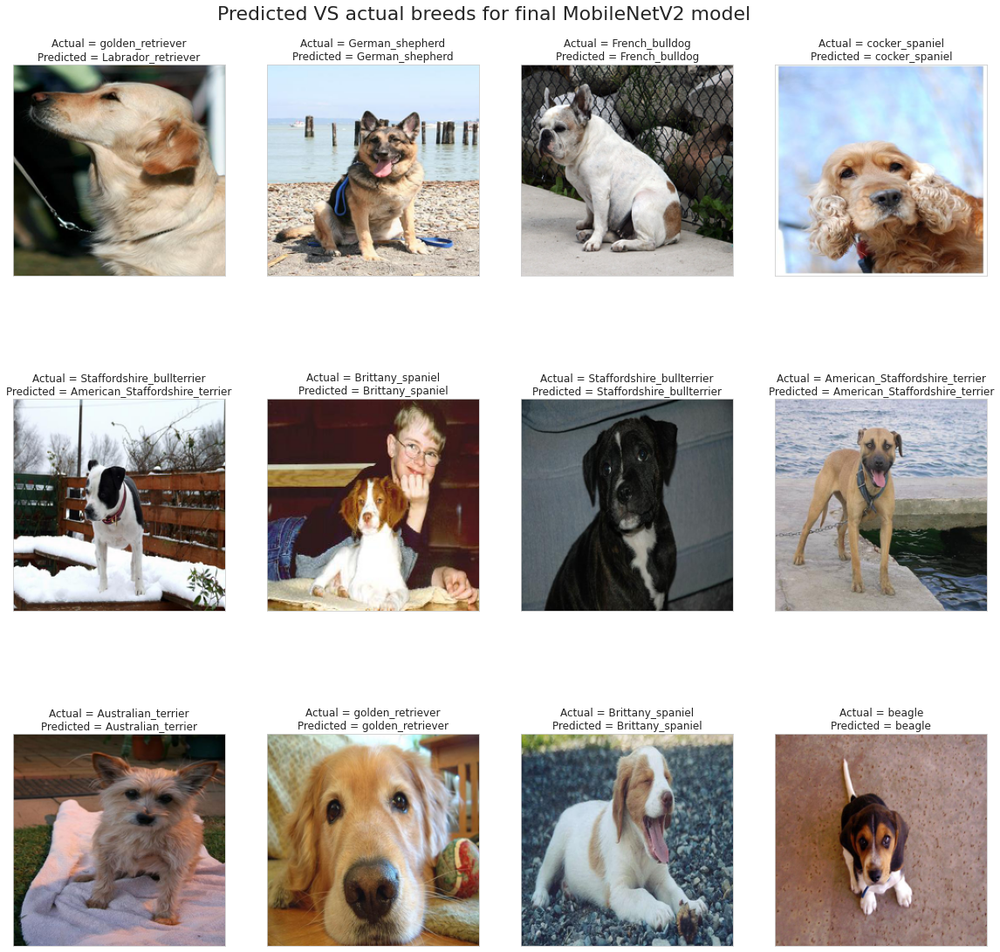

In [ ]:
breeds12_test_size = 389

fig = plt.figure(1, figsize=(20,20))
plt.suptitle("Predicted VS actual breeds for final MobileNetV2 model", 
             y = 0.9, fontsize=22)

for i in range(12):
  # Random number for indice
  r = int(np.random.randint(0, breeds12_test_size, 1))
  # Subplot
  plt.subplot(3,4,i+1)
  # Get images
  img = Image.open(breeds12_test_path + '/' + test_iterator.filenames[r])
  # Resize image
  img = img.resize((224, 224))
  # Display image
  plt.imshow((img))
  plt.title(
      'Actual = {}\nPredicted = {}'.format(list_breeds_it[actual_breeds[r]],
                                           list_breeds_it[pred_breeds[r]]))
  plt.xticks([]) , plt.yticks([])
    
plt.show()

Les prédictions sont correctes dans la majorité des cas. Il semble y avoir des erreurs lorsque les races sont proches physiquement.

### **8.2. Analyse des prédictions**
Nous visualisons les résultats via une matrice de confusion.

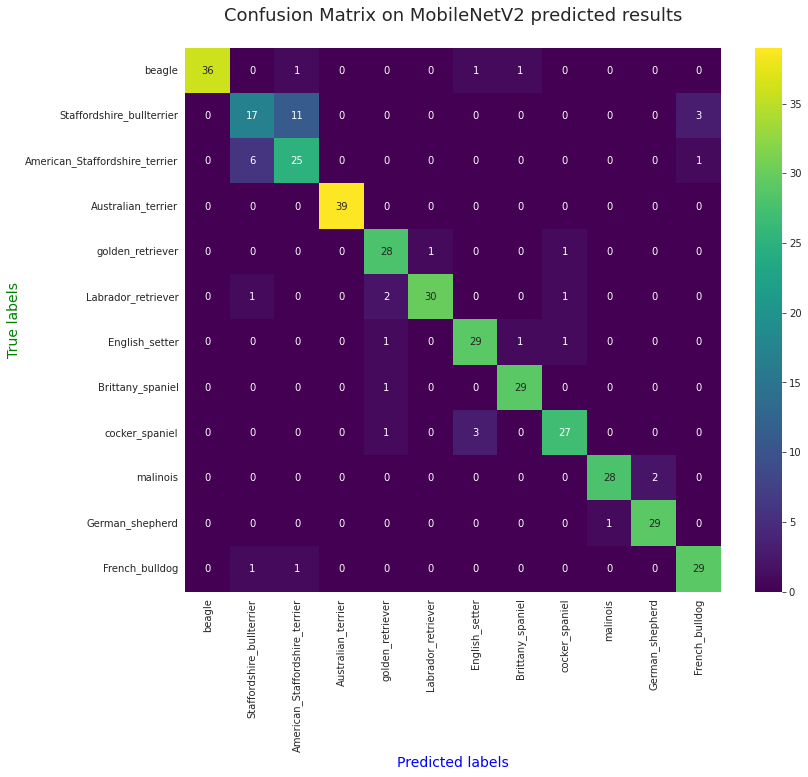

In [ ]:
# Compute confusion matrix
conf_matrix = confusion_matrix(actual_breeds, pred_breeds)

# Display confusion matrix as a heatmap
fig = plt.figure(figsize=(12,10))
ax = sns.heatmap(conf_matrix, annot=True, cmap = "viridis")
ax.set_xlabel("Predicted labels", color="blue", fontsize=14)
ax.set_ylabel("True labels", color="g", fontsize=14)
ax.xaxis.set_ticklabels(list_breeds_it, 
                        rotation='vertical')
ax.yaxis.set_ticklabels(list_breeds_it,
                        rotation='horizontal')
plt.title("Confusion Matrix on MobileNetV2 predicted results\n",
          fontsize=18)
plt.show()

La matrice affiche une diagonale qui contient bien majoritairement les prédictions correctes. Effectivement, pour des races proches physiquement (American_Staffordshire_terrier vs Staffordshire_bullterrier ou Labrador_retriever vs golden_retriever) le modèle a un peu plus de mal à faire les bonnes prédictions.

In [ ]:
# Display classification report
print(classification_report(actual_breeds, pred_breeds, 
                            target_names=list_breeds_it))

                                precision    recall  f1-score   support

                        beagle       1.00      0.92      0.96        39
     Staffordshire_bullterrier       0.68      0.55      0.61        31
American_Staffordshire_terrier       0.66      0.78      0.71        32
            Australian_terrier       1.00      1.00      1.00        39
              golden_retriever       0.85      0.93      0.89        30
            Labrador_retriever       0.97      0.88      0.92        34
                English_setter       0.88      0.91      0.89        32
              Brittany_spaniel       0.94      0.97      0.95        30
                cocker_spaniel       0.90      0.87      0.89        31
                      malinois       0.97      0.93      0.95        30
               German_shepherd       0.94      0.97      0.95        30
                French_bulldog       0.88      0.94      0.91        31

                      accuracy                           0.89 

Nous obtenons une accuracy de 0.89, ce qui est satisfaisant.

### **8.3. Squelette du script Python**
Nous construisons un squelette de script Python contenant une fonction de prédiction que nous utiliserons dans un fichier .py utilisé dans l'application Streamlit pour faire la prédiction d'une race à partir d'une image.

Nous le testons ici à partir d'une des images du jeu de test.

Race de chien prédite : English_setter avec 98.5% de chances


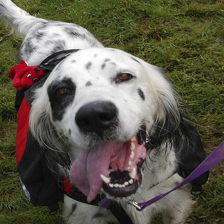

In [ ]:
from keras.applications.mobilenet_v2 import preprocess_input

# Load model
breeds12_model_file_path = breeds12_models_path + "/opt_model_MobileNetV2_ter.h5"

final_model = keras.models.load_model(breeds12_model_file_path)

# Load list
filename = breeds12_models_path + '/list_breeds.joblib'
list_breeds_it = joblib.load(filename)

# Get path to test image
eng_set_file_path = breeds12_test_path + '/n02100735-English_setter'

# List of images
list_eng_set_img = os.listdir(eng_set_file_path)

# Path to one image
eng_set_img_path = os.path.join(eng_set_file_path,list_eng_set_img[1])

test_img = Image.open(eng_set_img_path)

def breed_prediction(input_img, list_breeds) : 
  """
    Function to get breed prediction and display resized original image

    Arguments :
    - input_img : image to load
    - list_breeds : list with the breeds (= class names)

    Return : 
    - predicted breed
    - resized original image
  """
  # setting dimension of the resize
  SIZE = 224

    # resize image
  resized_img = input_img.resize((SIZE, SIZE))

  # Array
  img_array = np.array(resized_img)

  # Tensor
  img_tensor = img_array.reshape((1,)+img_array.shape)
  img_tensor_preproc = preprocess_input(img_tensor)

  # Prediction
  pred = final_model.predict(img_tensor_preproc)

  # Predicted breed
  pred_label = list_breeds[np.argmax(pred)]
  pred_perc = round(np.max(pred)*100,1)

  return pred_label, resized_img, pred_perc

print("Race de chien prédite : {} avec {}% de chances".format(
    breed_prediction(test_img, list_breeds_it)[0],
    breed_prediction(test_img, list_breeds_it)[2]))
breed_prediction(test_img, list_breeds_it)[1]

Le code définitif pour le script est disponible sur GitHub à [cette adresse](https://github.com/MarieFrance119/OCR_P6_Dog_Breeds_Predictions). Il est associé à Streamlit pour une interface plus conviviale, disponible [ici](https://share.streamlit.io/mariefrance119/ocr_p6_dog_breeds_predictions/main/program.py).